<a href="https://colab.research.google.com/github/Vemira08/NeuroPulse/blob/main/neuropulse_model.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [21]:
import shutil

shutil.rmtree('dataset_bdf')

#**Loading the Dataset**

In [22]:
from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [23]:
!cp /content/drive/MyDrive/Dataset/dataset.zip /content

In [24]:
!pip install mne

In [25]:
import zipfile

zip_path = "/content/dataset.zip"
extract_path = "/content/dataset_bdf"

with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(extract_path)


In [26]:
import os

dataset_path = "/content/dataset_bdf"

# Sub-folder paths for Healthy and Parkinson data
healthy_folder = os.path.join(dataset_path, "Healthy")
parkinson_folder = os.path.join(dataset_path, "Parkinson")


In [27]:
healthy_files = [os.path.join(healthy_folder, f) for f in os.listdir(healthy_folder) if f.endswith(".bdf")]
print("Healthy Files:", healthy_files)

parkinson_files = [os.path.join(parkinson_folder, f) for f in os.listdir(parkinson_folder) if f.endswith(".bdf")]
print("Parkinson Files:", parkinson_files)


Healthy Files: ['/content/dataset_bdf/Healthy/sub-hc18_ses-hc_task-rest_eeg.bdf', '/content/dataset_bdf/Healthy/sub-hc31_ses-hc_task-rest_eeg.bdf', '/content/dataset_bdf/Healthy/sub-hc2_ses-hc_task-rest_eeg.bdf', '/content/dataset_bdf/Healthy/sub-hc32_ses-hc_task-rest_eeg.bdf', '/content/dataset_bdf/Healthy/sub-hc25_ses-hc_task-rest_eeg.bdf', '/content/dataset_bdf/Healthy/sub-hc29_ses-hc_task-rest_eeg.bdf', '/content/dataset_bdf/Healthy/sub-hc21_ses-hc_task-rest_eeg.bdf', '/content/dataset_bdf/Healthy/sub-hc1_ses-hc_task-rest_eeg.bdf', '/content/dataset_bdf/Healthy/sub-hc8_ses-hc_task-rest_eeg.bdf', '/content/dataset_bdf/Healthy/sub-hc24_ses-hc_task-rest_eeg.bdf', '/content/dataset_bdf/Healthy/sub-hc7_ses-hc_task-rest_eeg.bdf', '/content/dataset_bdf/Healthy/sub-hc33_ses-hc_task-rest_eeg.bdf', '/content/dataset_bdf/Healthy/sub-hc10_ses-hc_task-rest_eeg.bdf', '/content/dataset_bdf/Healthy/sub-hc30_ses-hc_task-rest_eeg.bdf', '/content/dataset_bdf/Healthy/sub-hc20_ses-hc_task-rest_eeg.bdf'

In [28]:
import mne

sample_file = parkinson_files[20]  # Replace with parkinson_files[0] for PD files
raw_data = mne.io.read_raw_bdf(sample_file, preload=True)

# Print basic information about the dataset
print(raw_data.info)


Extracting EDF parameters from /content/dataset_bdf/Parkinson/sub-pd3_ses-on_task-rest_eeg.bdf...
BDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 109055  =      0.000 ...   212.998 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: Fp1, AF3, F7, F3, FC1, FC5, T7, C3, CP1, CP5, P7, P3, Pz, PO3, ...
 chs: 40 EEG, 1 Stimulus
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 104.0 Hz
 meas_date: 2011-01-26 11:21:36 UTC
 nchan: 41
 projs: []
 sfreq: 512.0 Hz
 subject_info: <subject_info | his_id: >
>


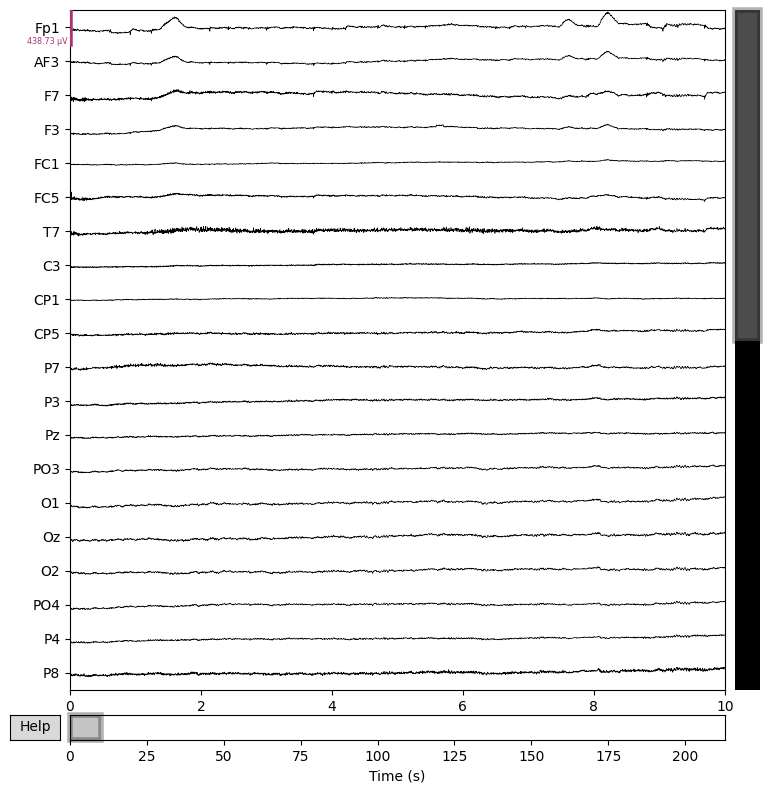

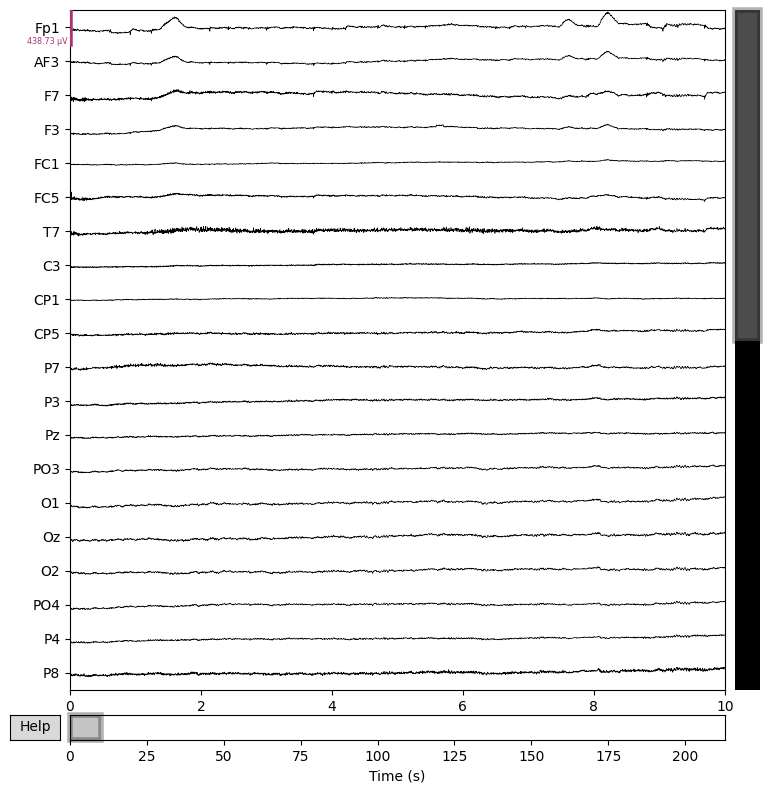

In [29]:
raw_data.plot(block=True, scalings='auto')


In [32]:
import numpy as np

# Determine the minimum time length from all files
min_time = float('inf')  # Start with a very large number
for file_path in healthy_files + parkinson_files:
    raw = mne.io.read_raw_bdf(file_path, preload=True)
    times = raw.times  # Get time array
    min_time = min(min_time, times[-1])  # Find min time

print(f"Min time across all files: {min_time:.2f} seconds")



Extracting EDF parameters from /content/dataset_bdf/Healthy/sub-hc18_ses-hc_task-rest_eeg.bdf...
BDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 95231  =      0.000 ...   185.998 secs...
Extracting EDF parameters from /content/dataset_bdf/Healthy/sub-hc31_ses-hc_task-rest_eeg.bdf...
BDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 95743  =      0.000 ...   186.998 secs...
Extracting EDF parameters from /content/dataset_bdf/Healthy/sub-hc2_ses-hc_task-rest_eeg.bdf...
BDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 99327  =      0.000 ...   193.998 secs...
Extracting EDF parameters from /content/dataset_bdf/Healthy/sub-hc32_ses-hc_task-rest_eeg.bdf...
BDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 100351  =      0.000 ...   195.998 secs...
Extracting EDF parameters from /content/dataset_bdf/Heal

Extracting EDF parameters from /content/dataset_bdf/Parkinson/sub-pd11_ses-on_task-rest_eeg.bdf...
BDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 95743  =      0.000 ...   186.998 secs...


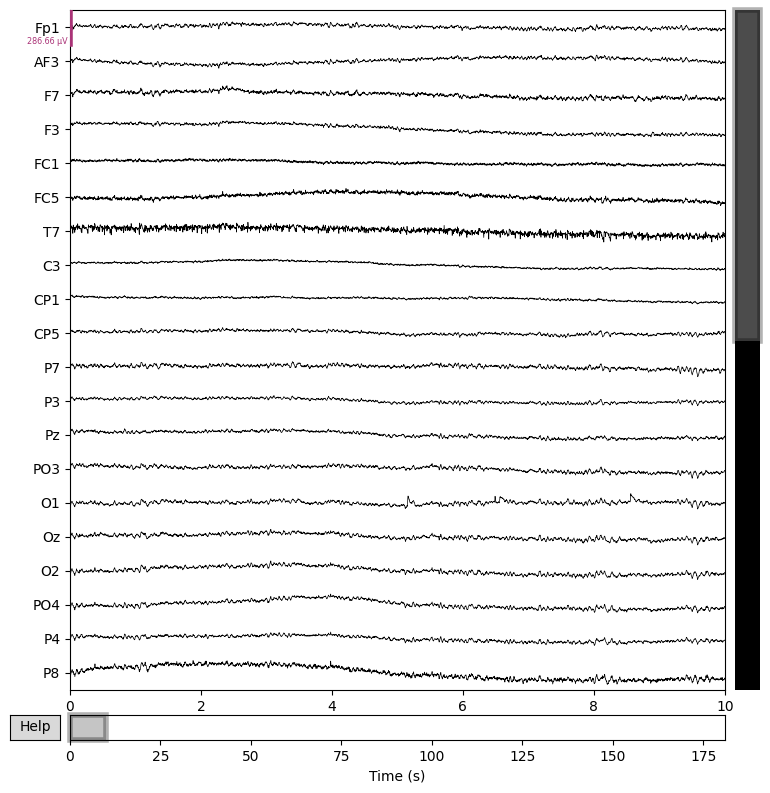

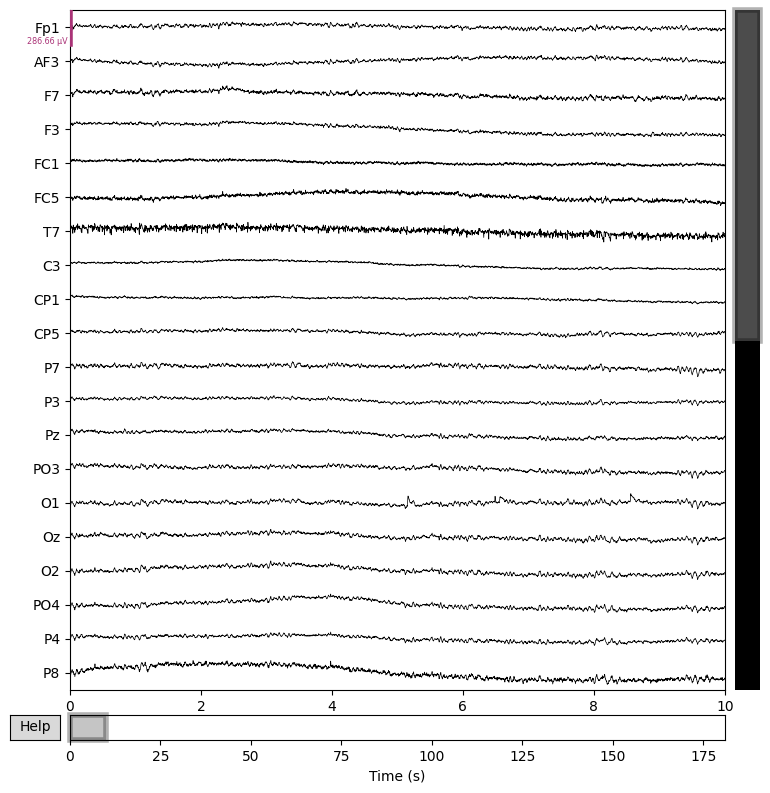

In [35]:
def standardize_data_to_min_time(raw, min_time, target_sampling_rate=128):
    # Get the original time length and the number of timepoints
    time_length = raw.times[-1]

    # Standardize the time range by trimming
    if time_length > min_time:
        raw.crop(tmin=0, tmax=min_time)  # Trim the longer data to min_time
    elif time_length < min_time:
        # If shorter, padding is unnecessary because you are trimming
        pass

    return raw

# Example: Standardize one of the files
sample_file = parkinson_files[10]
raw_data = mne.io.read_raw_bdf(sample_file, preload=True)

# Standardize to the minimum time
standardized_data = standardize_data_to_min_time(raw_data, min_time)

# Plot the standardized data
standardized_data.plot(block=True, scalings='auto')


In [40]:
import os
import mne

# Function to preprocess EEG data without plotting or automatic artifact rejection
def preprocess_eeg_data(raw, filter_low=1.0, filter_high=50.0, notch_freq=50.0, ica_components=20, downsample_rate=128):
    # 1. Apply bandpass filter (1-50 Hz)
    raw.filter(l_freq=filter_low, h_freq=filter_high)

    # 2. Apply notch filter (50 Hz to remove power line noise)
    raw.notch_filter(freqs=notch_freq)

    # 3. Detect and interpolate bad channels
    raw.interpolate_bads(reset_bads=True)

    # 4. Re-reference to the average of all channels
    raw.set_eeg_reference(ref_channels='average')

    # 5. Perform ICA to remove artifacts (without automatic artifact detection)
    ica = mne.preprocessing.ICA(n_components=ica_components, random_state=97, max_iter=800)
    ica.fit(raw)

    # Note: Skipping automatic artifact detection and applying ICA to data
    raw = ica.apply(raw)  # Apply ICA to the data

    # 6. Downsample to reduce data size and computational cost
    raw.resample(sfreq=downsample_rate)

    return raw

# Function to preprocess all files in a folder
def preprocess_all_files(folder_path, output_folder):
    # Iterate over all files in the folder
    for file_name in os.listdir(folder_path):
        if file_name.endswith(".bdf"):  # Only process .bdf files
            file_path = os.path.join(folder_path, file_name)
            print(f"Processing file: {file_path}")

            # Load raw data
            raw_data = mne.io.read_raw_bdf(file_path, preload=True)

            # Preprocess the data with the defined steps
            preprocessed_data = preprocess_eeg_data(raw_data)

            # Save the preprocessed data to the output folder
            output_file = os.path.join(output_folder, file_name.replace(".bdf", "-preprocessed.fif"))
            preprocessed_data.save(output_file, overwrite=True)
            print(f"Saved preprocessed data to: {output_file}")

# Paths for Healthy and Parkinson folders
healthy_folder = "/content/dataset_bdf/Healthy"
parkinson_folder = "/content/dataset_bdf/Parkinson"

# Output folders for preprocessed data
preprocessed_healthy_folder = "/content/preprocessed_data/Healthy"
preprocessed_parkinson_folder = "/content/preprocessed_data/Parkinson"

# Create output folders if they don't exist
os.makedirs(preprocessed_healthy_folder, exist_ok=True)
os.makedirs(preprocessed_parkinson_folder, exist_ok=True)



In [41]:
# Preprocess all files in both Healthy and Parkinson folders
print("Preprocessing Healthy Files...")
preprocess_all_files(healthy_folder, preprocessed_healthy_folder)

Preprocessing Healthy Files...
Processing file: /content/dataset_bdf/Healthy/sub-hc18_ses-hc_task-rest_eeg.bdf
Extracting EDF parameters from /content/dataset_bdf/Healthy/sub-hc18_ses-hc_task-rest_eeg.bdf...
BDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 95231  =      0.000 ...   185.998 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 1691 samples (3.303 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s


Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 3381 samples (6.604 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.3s


Setting channel interpolation method to {'eeg': 'spline'}.
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Fitting ICA to data using 40 channels (please be patient, this may take a while)


<ipython-input-40-e706683225f6>:13: RuntimeWarning: No bad channels to interpolate. Doing nothing...
  raw.interpolate_bads(reset_bads=True)


Selecting by number: 20 components
Fitting ICA took 6.6s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 40 PCA components
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Writing /content/preprocessed_data/Healthy/sub-hc18_ses-hc_task-rest_eeg-preprocessed.fif
Closing /content/preprocessed_data/Healthy/sub-hc18_ses-hc_task-rest_eeg-preprocessed.fif
[done]
Saved preprocessed data to: /content/preprocessed_data/Healthy/sub-hc18_ses-hc_task-rest_eeg-preprocessed.fif
Processing file: /content/dataset_bdf/Healt

<ipython-input-40-e706683225f6>:46: RuntimeWarning: This filename (/content/preprocessed_data/Healthy/sub-hc18_ses-hc_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  preprocessed_data.save(output_file, overwrite=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 1691 samples (3.303 s)

Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edg

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Setting channel interpolation method to {'eeg': 'spline'}.
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Fitting ICA to data using 40 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
<ipython-input-40-e706683225f6>:13: RuntimeWarning: No bad channels to interpolate. Doing nothing...
  raw.interpolate_bads(reset_bads=True)


Selecting by number: 20 components
Fitting ICA took 5.3s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 40 PCA components
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Writing /content/preprocessed_data/Healthy/sub-hc31_ses-hc_task-rest_eeg-preprocessed.fif
Closing /content/preprocessed_data/Healthy/sub-hc31_ses-hc_task-rest_eeg-preprocessed.fif
[done]
Saved preprocessed data to: /content/preprocessed_data/Healthy/sub-hc31_ses-hc_task-rest_eeg-preprocessed.fif
Processing file: /content/dataset_bdf/Healt

<ipython-input-40-e706683225f6>:46: RuntimeWarning: This filename (/content/preprocessed_data/Healthy/sub-hc31_ses-hc_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  preprocessed_data.save(output_file, overwrite=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 1691 samples (3.303 s)

Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edg

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Setting channel interpolation method to {'eeg': 'spline'}.
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Fitting ICA to data using 40 channels (please be patient, this may take a while)


<ipython-input-40-e706683225f6>:13: RuntimeWarning: No bad channels to interpolate. Doing nothing...
  raw.interpolate_bads(reset_bads=True)


Selecting by number: 20 components
Fitting ICA took 5.4s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 40 PCA components
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Writing /content/preprocessed_data/Healthy/sub-hc2_ses-hc_task-rest_eeg-preprocessed.fif
Closing /content/preprocessed_data/Healthy/sub-hc2_ses-hc_task-rest_eeg-preprocessed.fif
[done]
Saved preprocessed data to: /content/preprocessed_data/Healthy/sub-hc2_ses-hc_task-rest_eeg-preprocessed.fif
Processing file: /content/dataset_bdf/Healthy/

<ipython-input-40-e706683225f6>:46: RuntimeWarning: This filename (/content/preprocessed_data/Healthy/sub-hc2_ses-hc_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  preprocessed_data.save(output_file, overwrite=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 1691 samples (3.303 s)

Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edg

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Setting channel interpolation method to {'eeg': 'spline'}.
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Fitting ICA to data using 40 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
<ipython-input-40-e706683225f6>:13: RuntimeWarning: No bad channels to interpolate. Doing nothing...
  raw.interpolate_bads(reset_bads=True)


Selecting by number: 20 components
Fitting ICA took 8.1s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 40 PCA components
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Writing /content/preprocessed_data/Healthy/sub-hc32_ses-hc_task-rest_eeg-preprocessed.fif
Closing /content/preprocessed_data/Healthy/sub-hc32_ses-hc_task-rest_eeg-preprocessed.fif
[done]
Saved preprocessed data to: /content/preprocessed_data/Healthy/sub-hc32_ses-hc_task-rest_eeg-preprocessed.fif
Processing file: /content/dataset_bdf/Healt

<ipython-input-40-e706683225f6>:46: RuntimeWarning: This filename (/content/preprocessed_data/Healthy/sub-hc32_ses-hc_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  preprocessed_data.save(output_file, overwrite=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 1691 samples (3.303 s)

Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edg

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Setting channel interpolation method to {'eeg': 'spline'}.
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
<ipython-input-40-e706683225f6>:13: RuntimeWarning: No bad channels to interpolate. Doing nothing...
  raw.interpolate_bads(reset_bads=True)


Fitting ICA to data using 40 channels (please be patient, this may take a while)
Selecting by number: 20 components
Fitting ICA took 8.1s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 40 PCA components
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Writing /content/preprocessed_data/Healthy/sub-hc25_ses-hc_task-rest_eeg-preprocessed.fif
Closing /content/preprocessed_data/Healthy/sub-hc25_ses-hc_task-rest_eeg-preprocessed.fif
[done]
Saved preprocessed data to: /content/preprocessed_data/Healthy/sub-hc25_

<ipython-input-40-e706683225f6>:46: RuntimeWarning: This filename (/content/preprocessed_data/Healthy/sub-hc25_ses-hc_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  preprocessed_data.save(output_file, overwrite=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 1691 samples (3.303 s)

Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edg

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Setting channel interpolation method to {'eeg': 'spline'}.
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Fitting ICA to data using 40 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
<ipython-input-40-e706683225f6>:13: RuntimeWarning: No bad channels to interpolate. Doing nothing...
  raw.interpolate_bads(reset_bads=True)


Selecting by number: 20 components
Fitting ICA took 5.4s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 40 PCA components
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Writing /content/preprocessed_data/Healthy/sub-hc29_ses-hc_task-rest_eeg-preprocessed.fif
Closing /content/preprocessed_data/Healthy/sub-hc29_ses-hc_task-rest_eeg-preprocessed.fif
[done]
Saved preprocessed data to: /content/preprocessed_data/Healthy/sub-hc29_ses-hc_task-rest_eeg-preprocessed.fif
Processing file: /content/dataset_bdf/Healt

<ipython-input-40-e706683225f6>:46: RuntimeWarning: This filename (/content/preprocessed_data/Healthy/sub-hc29_ses-hc_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  preprocessed_data.save(output_file, overwrite=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 1691 samples (3.303 s)

Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edg

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Setting channel interpolation method to {'eeg': 'spline'}.
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
<ipython-input-40-e706683225f6>:13: RuntimeWarning: No bad channels to interpolate. Doing nothing...
  raw.interpolate_bads(reset_bads=True)


Fitting ICA to data using 40 channels (please be patient, this may take a while)
Selecting by number: 20 components
Fitting ICA took 5.6s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 40 PCA components
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Writing /content/preprocessed_data/Healthy/sub-hc21_ses-hc_task-rest_eeg-preprocessed.fif
Closing /content/preprocessed_data/Healthy/sub-hc21_ses-hc_task-rest_eeg-preprocessed.fif
[done]
Saved preprocessed data to: /content/preprocessed_data/Healthy/sub-hc21_

<ipython-input-40-e706683225f6>:46: RuntimeWarning: This filename (/content/preprocessed_data/Healthy/sub-hc21_ses-hc_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  preprocessed_data.save(output_file, overwrite=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 1691 samples (3.303 s)

Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edg

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Setting channel interpolation method to {'eeg': 'spline'}.
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Fitting ICA to data using 40 channels (please be patient, this may take a while)


<ipython-input-40-e706683225f6>:13: RuntimeWarning: No bad channels to interpolate. Doing nothing...
  raw.interpolate_bads(reset_bads=True)


Selecting by number: 20 components
Fitting ICA took 12.5s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 40 PCA components
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Writing /content/preprocessed_data/Healthy/sub-hc1_ses-hc_task-rest_eeg-preprocessed.fif
Closing /content/preprocessed_data/Healthy/sub-hc1_ses-hc_task-rest_eeg-preprocessed.fif
[done]
Saved preprocessed data to: /content/preprocessed_data/Healthy/sub-hc1_ses-hc_task-rest_eeg-preprocessed.fif
Processing file: /content/dataset_bdf/Healthy

<ipython-input-40-e706683225f6>:46: RuntimeWarning: This filename (/content/preprocessed_data/Healthy/sub-hc1_ses-hc_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  preprocessed_data.save(output_file, overwrite=True)



FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 1691 samples (3.303 s)

Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
-

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Setting channel interpolation method to {'eeg': 'spline'}.
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Fitting ICA to data using 40 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
<ipython-input-40-e706683225f6>:13: RuntimeWarning: No bad channels to interpolate. Doing nothing...
  raw.interpolate_bads(reset_bads=True)


Selecting by number: 20 components
Fitting ICA took 7.9s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 40 PCA components
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Writing /content/preprocessed_data/Healthy/sub-hc8_ses-hc_task-rest_eeg-preprocessed.fif
Closing /content/preprocessed_data/Healthy/sub-hc8_ses-hc_task-rest_eeg-preprocessed.fif
[done]
Saved preprocessed data to: /content/preprocessed_data/Healthy/sub-hc8_ses-hc_task-rest_eeg-preprocessed.fif
Processing file: /content/dataset_bdf/Healthy/

<ipython-input-40-e706683225f6>:46: RuntimeWarning: This filename (/content/preprocessed_data/Healthy/sub-hc8_ses-hc_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  preprocessed_data.save(output_file, overwrite=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 1691 samples (3.303 s)

Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edg

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Setting channel interpolation method to {'eeg': 'spline'}.
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Fitting ICA to data using 40 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
<ipython-input-40-e706683225f6>:13: RuntimeWarning: No bad channels to interpolate. Doing nothing...
  raw.interpolate_bads(reset_bads=True)


Selecting by number: 20 components
Fitting ICA took 10.7s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 40 PCA components
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Writing /content/preprocessed_data/Healthy/sub-hc24_ses-hc_task-rest_eeg-preprocessed.fif
Closing /content/preprocessed_data/Healthy/sub-hc24_ses-hc_task-rest_eeg-preprocessed.fif
[done]
Saved preprocessed data to: /content/preprocessed_data/Healthy/sub-hc24_ses-hc_task-rest_eeg-preprocessed.fif
Processing file: /content/dataset_bdf/Heal

<ipython-input-40-e706683225f6>:46: RuntimeWarning: This filename (/content/preprocessed_data/Healthy/sub-hc24_ses-hc_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  preprocessed_data.save(output_file, overwrite=True)


- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 1691 samples (3.303 s)

Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 3381 samples (6.604 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Setting channel interpolation method to {'eeg': 'spline'}.
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Fitting ICA to data using 40 channels (please be patient, this may take a while)


<ipython-input-40-e706683225f6>:13: RuntimeWarning: No bad channels to interpolate. Doing nothing...
  raw.interpolate_bads(reset_bads=True)


Selecting by number: 20 components
Fitting ICA took 7.7s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 40 PCA components
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Writing /content/preprocessed_data/Healthy/sub-hc7_ses-hc_task-rest_eeg-preprocessed.fif
Closing /content/preprocessed_data/Healthy/sub-hc7_ses-hc_task-rest_eeg-preprocessed.fif
[done]
Saved preprocessed data to: /content/preprocessed_data/Healthy/sub-hc7_ses-hc_task-rest_eeg-preprocessed.fif
Processing file: /content/dataset_bdf/Healthy/

<ipython-input-40-e706683225f6>:46: RuntimeWarning: This filename (/content/preprocessed_data/Healthy/sub-hc7_ses-hc_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  preprocessed_data.save(output_file, overwrite=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 1691 samples (3.303 s)

Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edg

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Setting channel interpolation method to {'eeg': 'spline'}.
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Fitting ICA to data using 40 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
<ipython-input-40-e706683225f6>:13: RuntimeWarning: No bad channels to interpolate. Doing nothing...
  raw.interpolate_bads(reset_bads=True)


Selecting by number: 20 components
Fitting ICA took 6.6s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 40 PCA components
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Writing /content/preprocessed_data/Healthy/sub-hc33_ses-hc_task-rest_eeg-preprocessed.fif
Closing /content/preprocessed_data/Healthy/sub-hc33_ses-hc_task-rest_eeg-preprocessed.fif
[done]
Saved preprocessed data to: /content/preprocessed_data/Healthy/sub-hc33_ses-hc_task-rest_eeg-preprocessed.fif
Processing file: /content/dataset_bdf/Healt

<ipython-input-40-e706683225f6>:46: RuntimeWarning: This filename (/content/preprocessed_data/Healthy/sub-hc33_ses-hc_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  preprocessed_data.save(output_file, overwrite=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 1691 samples (3.303 s)

Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edg

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Setting channel interpolation method to {'eeg': 'spline'}.
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Fitting ICA to data using 40 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
<ipython-input-40-e706683225f6>:13: RuntimeWarning: No bad channels to interpolate. Doing nothing...
  raw.interpolate_bads(reset_bads=True)


Selecting by number: 20 components
Fitting ICA took 8.7s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 40 PCA components
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Writing /content/preprocessed_data/Healthy/sub-hc10_ses-hc_task-rest_eeg-preprocessed.fif
Closing /content/preprocessed_data/Healthy/sub-hc10_ses-hc_task-rest_eeg-preprocessed.fif
[done]
Saved preprocessed data to: /content/preprocessed_data/Healthy/sub-hc10_ses-hc_task-rest_eeg-preprocessed.fif
Processing file: /content/dataset_bdf/Healt

<ipython-input-40-e706683225f6>:46: RuntimeWarning: This filename (/content/preprocessed_data/Healthy/sub-hc10_ses-hc_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  preprocessed_data.save(output_file, overwrite=True)


FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 1691 samples (3.303 s)

Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Setting channel interpolation method to {'eeg': 'spline'}.
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Fitting ICA to data using 40 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
<ipython-input-40-e706683225f6>:13: RuntimeWarning: No bad channels to interpolate. Doing nothing...
  raw.interpolate_bads(reset_bads=True)


Selecting by number: 20 components
Fitting ICA took 3.3s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 40 PCA components
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Writing /content/preprocessed_data/Healthy/sub-hc30_ses-hc_task-rest_eeg-preprocessed.fif
Closing /content/preprocessed_data/Healthy/sub-hc30_ses-hc_task-rest_eeg-preprocessed.fif
[done]
Saved preprocessed data to: /content/preprocessed_data/Healthy/sub-hc30_ses-hc_task-rest_eeg-preprocessed.fif
Processing file: /content/dataset_bdf/Healt

<ipython-input-40-e706683225f6>:46: RuntimeWarning: This filename (/content/preprocessed_data/Healthy/sub-hc30_ses-hc_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  preprocessed_data.save(output_file, overwrite=True)


Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 3381 samples (6.604 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Setting channel interpolation method to {'eeg': 'spline'}.
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Fitting ICA to data using 40 channels (please be patient, this may take a while)


<ipython-input-40-e706683225f6>:13: RuntimeWarning: No bad channels to interpolate. Doing nothing...
  raw.interpolate_bads(reset_bads=True)


Selecting by number: 20 components
Fitting ICA took 7.0s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 40 PCA components
1 event found on stim channel Status
Event IDs: [1]
1 event found on stim channel Status
Event IDs: [1]
Writing /content/preprocessed_data/Healthy/sub-hc20_ses-hc_task-rest_eeg-preprocessed.fif
Closing /content/preprocessed_data/Healthy/sub-hc20_ses-hc_task-rest_eeg-preprocessed.fif
[done]
Saved preprocessed data to: /content/preprocessed_data/Healthy/sub-hc20_ses-hc_task-rest_eeg-preprocessed.fif
Processing file: /content/dataset_bdf/Healthy/sub-hc4_ses-hc_task-rest_eeg.bdf
Extracting EDF parameters from /content/dataset_bdf/Healthy/sub-hc4_ses-hc_task-rest_eeg.bdf...
BDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 92671  =      0.000 ...   180.998 secs...


<ipython-input-40-e706683225f6>:46: RuntimeWarning: This filename (/content/preprocessed_data/Healthy/sub-hc20_ses-hc_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  preprocessed_data.save(output_file, overwrite=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 1691 samples (3.303 s)

Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edg

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Setting channel interpolation method to {'eeg': 'spline'}.
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Fitting ICA to data using 40 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
<ipython-input-40-e706683225f6>:13: RuntimeWarning: No bad channels to interpolate. Doing nothing...
  raw.interpolate_bads(reset_bads=True)


Selecting by number: 20 components
Fitting ICA took 8.0s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 40 PCA components
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Writing /content/preprocessed_data/Healthy/sub-hc4_ses-hc_task-rest_eeg-preprocessed.fif
Closing /content/preprocessed_data/Healthy/sub-hc4_ses-hc_task-rest_eeg-preprocessed.fif
[done]
Saved preprocessed data to: /content/preprocessed_data/Healthy/sub-hc4_ses-hc_task-rest_eeg-preprocessed.fif


<ipython-input-40-e706683225f6>:46: RuntimeWarning: This filename (/content/preprocessed_data/Healthy/sub-hc4_ses-hc_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  preprocessed_data.save(output_file, overwrite=True)


In [42]:
print("Preprocessing Parkinson Files...")
preprocess_all_files(parkinson_folder, preprocessed_parkinson_folder)

print("Preprocessing complete for all files!")

Preprocessing Parkinson Files...
Processing file: /content/dataset_bdf/Parkinson/sub-pd6_ses-on_task-rest_eeg.bdf
Extracting EDF parameters from /content/dataset_bdf/Parkinson/sub-pd6_ses-on_task-rest_eeg.bdf...
BDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 147967  =      0.000 ...   288.998 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 1691 samples (3.303 s)

Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Setting channel interpolation method to {'eeg': 'spline'}.
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Fitting ICA to data using 40 channels (please be patient, this may take a while)


<ipython-input-40-e706683225f6>:13: RuntimeWarning: No bad channels to interpolate. Doing nothing...
  raw.interpolate_bads(reset_bads=True)


Selecting by number: 20 components
Fitting ICA took 13.0s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 40 PCA components
Trigger channel Status has a non-zero initial value of 98304 (consider using initial_event=True to detect this event)
1 event found on stim channel Status
Event IDs: [98304]
Trigger channel Status has a non-zero initial value of 98304 (consider using initial_event=True to detect this event)
Writing /content/preprocessed_data/Parkinson/sub-pd6_ses-on_task-rest_eeg-preprocessed.fif
Closing /content/preprocessed_data/Parkinson/sub-pd6_ses-on_task-rest_eeg-preprocessed.fif
[done]
Saved preprocessed data to: /content/preprocessed_data/Parkinson/sub-pd6_ses-on_task-rest_eeg-preprocessed.fif
Processing file: /content/dataset_bdf/Parkinson/sub-pd26_ses-off_task-rest_eeg.bdf
Extracting EDF parameters from /content/dataset_bdf/Parkinson/sub-pd26_ses-off_task-rest_eeg.bdf...
BDF file detec

<ipython-input-40-e706683225f6>:26: RuntimeWarning: Resampling of the stim channels caused event information to become unreliable. Consider finding events on the original data and passing the event matrix as a parameter.
  raw.resample(sfreq=downsample_rate)
<ipython-input-40-e706683225f6>:46: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd6_ses-on_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  preprocessed_data.save(output_file, overwrite=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 1691 samples (3.303 s)

Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edg

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Setting channel interpolation method to {'eeg': 'spline'}.
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Fitting ICA to data using 40 channels (please be patient, this may take a while)


<ipython-input-40-e706683225f6>:13: RuntimeWarning: No bad channels to interpolate. Doing nothing...
  raw.interpolate_bads(reset_bads=True)


Selecting by number: 20 components
Fitting ICA took 6.3s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 40 PCA components
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Writing /content/preprocessed_data/Parkinson/sub-pd26_ses-off_task-rest_eeg-preprocessed.fif
Closing /content/preprocessed_data/Parkinson/sub-pd26_ses-off_task-rest_eeg-preprocessed.fif
[done]
Saved preprocessed data to: /content/preprocessed_data/Parkinson/sub-pd26_ses-off_task-rest_eeg-preprocessed.fif
Processing file: /content/dataset_

<ipython-input-40-e706683225f6>:46: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd26_ses-off_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  preprocessed_data.save(output_file, overwrite=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 1691 samples (3.303 s)

Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edg

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Setting channel interpolation method to {'eeg': 'spline'}.
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Fitting ICA to data using 40 channels (please be patient, this may take a while)


<ipython-input-40-e706683225f6>:13: RuntimeWarning: No bad channels to interpolate. Doing nothing...
  raw.interpolate_bads(reset_bads=True)


Selecting by number: 20 components
Fitting ICA took 2.7s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 40 PCA components
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Writing /content/preprocessed_data/Parkinson/sub-pd17_ses-on_task-rest_eeg-preprocessed.fif
Closing /content/preprocessed_data/Parkinson/sub-pd17_ses-on_task-rest_eeg-preprocessed.fif
[done]
Saved preprocessed data to: /content/preprocessed_data/Parkinson/sub-pd17_ses-on_task-rest_eeg-preprocessed.fif
Processing file: /content/dataset_bdf

<ipython-input-40-e706683225f6>:46: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd17_ses-on_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  preprocessed_data.save(output_file, overwrite=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 1691 samples (3.303 s)

Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edg

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Setting channel interpolation method to {'eeg': 'spline'}.
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Fitting ICA to data using 40 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
<ipython-input-40-e706683225f6>:13: RuntimeWarning: No bad channels to interpolate. Doing nothing...
  raw.interpolate_bads(reset_bads=True)


Selecting by number: 20 components
Fitting ICA took 8.1s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 40 PCA components
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Writing /content/preprocessed_data/Parkinson/sub-pd9_ses-off_task-rest_eeg-preprocessed.fif
Closing /content/preprocessed_data/Parkinson/sub-pd9_ses-off_task-rest_eeg-preprocessed.fif
[done]
Saved preprocessed data to: /content/preprocessed_data/Parkinson/sub-pd9_ses-off_task-rest_eeg-preprocessed.fif
Processing file: /content/dataset_bdf

<ipython-input-40-e706683225f6>:46: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd9_ses-off_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  preprocessed_data.save(output_file, overwrite=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 1691 samples (3.303 s)

Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edg

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Setting channel interpolation method to {'eeg': 'spline'}.
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Fitting ICA to data using 40 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
<ipython-input-40-e706683225f6>:13: RuntimeWarning: No bad channels to interpolate. Doing nothing...
  raw.interpolate_bads(reset_bads=True)


Selecting by number: 20 components
Fitting ICA took 4.3s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 40 PCA components
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Writing /content/preprocessed_data/Parkinson/sub-pd19_ses-on_task-rest_eeg-preprocessed.fif
Closing /content/preprocessed_data/Parkinson/sub-pd19_ses-on_task-rest_eeg-preprocessed.fif
[done]
Saved preprocessed data to: /content/preprocessed_data/Parkinson/sub-pd19_ses-on_task-rest_eeg-preprocessed.fif
Processing file: /content/dataset_bdf

<ipython-input-40-e706683225f6>:46: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd19_ses-on_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  preprocessed_data.save(output_file, overwrite=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 1691 samples (3.303 s)

Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edg

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Setting channel interpolation method to {'eeg': 'spline'}.
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Fitting ICA to data using 40 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
<ipython-input-40-e706683225f6>:13: RuntimeWarning: No bad channels to interpolate. Doing nothing...
  raw.interpolate_bads(reset_bads=True)


Selecting by number: 20 components
Fitting ICA took 13.5s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 40 PCA components
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Writing /content/preprocessed_data/Parkinson/sub-pd9_ses-on_task-rest_eeg-preprocessed.fif
Closing /content/preprocessed_data/Parkinson/sub-pd9_ses-on_task-rest_eeg-preprocessed.fif
[done]
Saved preprocessed data to: /content/preprocessed_data/Parkinson/sub-pd9_ses-on_task-rest_eeg-preprocessed.fif
Processing file: /content/dataset_bdf/P

<ipython-input-40-e706683225f6>:46: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd9_ses-on_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  preprocessed_data.save(output_file, overwrite=True)


Setting up band-pass filter from 1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 1691 samples (3.303 s)

Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Setting channel interpolation method to {'eeg': 'spline'}.
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Fitting ICA to data using 40 channels (please be patient, this may take a while)


<ipython-input-40-e706683225f6>:13: RuntimeWarning: No bad channels to interpolate. Doing nothing...
  raw.interpolate_bads(reset_bads=True)


Selecting by number: 20 components
Fitting ICA took 4.1s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 40 PCA components
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Writing /content/preprocessed_data/Parkinson/sub-pd19_ses-off_task-rest_eeg-preprocessed.fif
Closing /content/preprocessed_data/Parkinson/sub-pd19_ses-off_task-rest_eeg-preprocessed.fif
[done]
Saved preprocessed data to: /content/preprocessed_data/Parkinson/sub-pd19_ses-off_task-rest_eeg-preprocessed.fif
Processing file: /content/dataset_

<ipython-input-40-e706683225f6>:46: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd19_ses-off_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  preprocessed_data.save(output_file, overwrite=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 1691 samples (3.303 s)

Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edg

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Setting channel interpolation method to {'eeg': 'spline'}.
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Fitting ICA to data using 40 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
<ipython-input-40-e706683225f6>:13: RuntimeWarning: No bad channels to interpolate. Doing nothing...
  raw.interpolate_bads(reset_bads=True)


Selecting by number: 20 components
Fitting ICA took 8.5s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 40 PCA components
Trigger channel Status has a non-zero initial value of 32767 (consider using initial_event=True to detect this event)
1 event found on stim channel Status
Event IDs: [131071]


<ipython-input-40-e706683225f6>:20: RuntimeWarning: Using n_components=20 (resulting in n_components_=20) may lead to an unstable mixing matrix estimation because the ratio between the largest (40) and smallest (1.6e-05) variances is too large (> 1e6); consider setting n_components=0.999999 or an integer <= 14
  ica.fit(raw)


Trigger channel Status has a non-zero initial value of 32767 (consider using initial_event=True to detect this event)
1 event found on stim channel Status
Event IDs: [98304]
Writing /content/preprocessed_data/Parkinson/sub-pd16_ses-on_task-rest_eeg-preprocessed.fif
Closing /content/preprocessed_data/Parkinson/sub-pd16_ses-on_task-rest_eeg-preprocessed.fif
[done]
Saved preprocessed data to: /content/preprocessed_data/Parkinson/sub-pd16_ses-on_task-rest_eeg-preprocessed.fif
Processing file: /content/dataset_bdf/Parkinson/sub-pd13_ses-on_task-rest_eeg.bdf
Extracting EDF parameters from /content/dataset_bdf/Parkinson/sub-pd13_ses-on_task-rest_eeg.bdf...
BDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 95743  =      0.000 ...   186.998 secs...


<ipython-input-40-e706683225f6>:46: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd16_ses-on_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  preprocessed_data.save(output_file, overwrite=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 1691 samples (3.303 s)

Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edg

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Setting channel interpolation method to {'eeg': 'spline'}.
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Fitting ICA to data using 40 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
<ipython-input-40-e706683225f6>:13: RuntimeWarning: No bad channels to interpolate. Doing nothing...
  raw.interpolate_bads(reset_bads=True)


Selecting by number: 20 components
Fitting ICA took 8.5s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 40 PCA components
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Writing /content/preprocessed_data/Parkinson/sub-pd13_ses-on_task-rest_eeg-preprocessed.fif
Closing /content/preprocessed_data/Parkinson/sub-pd13_ses-on_task-rest_eeg-preprocessed.fif
[done]
Saved preprocessed data to: /content/preprocessed_data/Parkinson/sub-pd13_ses-on_task-rest_eeg-preprocessed.fif
Processing file: /content/dataset_bdf

<ipython-input-40-e706683225f6>:46: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd13_ses-on_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  preprocessed_data.save(output_file, overwrite=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 1691 samples (3.303 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 3381 samples (6.604 s)

Setting channel interpolation method to {'eeg': 'spline'}.
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
<ipython-input-40-e706683225f6>:13: RuntimeWarning: No bad channels to interpolate. Doing nothing...
  raw.interpolate_bads(reset_bads=True)


Fitting ICA to data using 40 channels (please be patient, this may take a while)
Selecting by number: 20 components
Fitting ICA took 8.2s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 40 PCA components
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Writing /content/preprocessed_data/Parkinson/sub-pd26_ses-on_task-rest_eeg-preprocessed.fif
Closing /content/preprocessed_data/Parkinson/sub-pd26_ses-on_task-rest_eeg-preprocessed.fif
[done]
Saved preprocessed data to: /content/preprocessed_data/Parkinson/sub

<ipython-input-40-e706683225f6>:46: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd26_ses-on_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  preprocessed_data.save(output_file, overwrite=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 1691 samples (3.303 s)

Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edg

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Setting channel interpolation method to {'eeg': 'spline'}.
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Fitting ICA to data using 40 channels (please be patient, this may take a while)


<ipython-input-40-e706683225f6>:13: RuntimeWarning: No bad channels to interpolate. Doing nothing...
  raw.interpolate_bads(reset_bads=True)


Selecting by number: 20 components
Fitting ICA took 7.6s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 40 PCA components
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Writing /content/preprocessed_data/Parkinson/sub-pd11_ses-on_task-rest_eeg-preprocessed.fif
Closing /content/preprocessed_data/Parkinson/sub-pd11_ses-on_task-rest_eeg-preprocessed.fif
[done]
Saved preprocessed data to: /content/preprocessed_data/Parkinson/sub-pd11_ses-on_task-rest_eeg-preprocessed.fif
Processing file: /content/dataset_bdf

<ipython-input-40-e706683225f6>:46: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd11_ses-on_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  preprocessed_data.save(output_file, overwrite=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 1691 samples (3.303 s)

Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edg

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Setting channel interpolation method to {'eeg': 'spline'}.
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Fitting ICA to data using 40 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
<ipython-input-40-e706683225f6>:13: RuntimeWarning: No bad channels to interpolate. Doing nothing...
  raw.interpolate_bads(reset_bads=True)


Selecting by number: 20 components
Fitting ICA took 4.2s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 40 PCA components
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
2 events found on stim channel Status
Event IDs: [    1 65536]
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
2 events found on stim channel Status
Event IDs: [    1 65536]
Writing /content/preprocessed_data/Parkinson/sub-pd17_ses-off_task-rest_eeg-preprocessed.fif
Closing /content/preprocessed_data/Parkinson/sub-pd17_ses-off_task-rest_eeg-preprocessed.fif
[done]
Saved preprocessed data to: /content/preprocessed_data/Parkinson/sub-pd17_ses-off_task-rest_eeg-preprocessed.fif
Processing f

<ipython-input-40-e706683225f6>:46: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd17_ses-off_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  preprocessed_data.save(output_file, overwrite=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 1691 samples (3.303 s)

Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edg

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Setting channel interpolation method to {'eeg': 'spline'}.
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Fitting ICA to data using 40 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
<ipython-input-40-e706683225f6>:13: RuntimeWarning: No bad channels to interpolate. Doing nothing...
  raw.interpolate_bads(reset_bads=True)


Selecting by number: 20 components
Fitting ICA took 3.8s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 40 PCA components
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Writing /content/preprocessed_data/Parkinson/sub-pd5_ses-on_task-rest_eeg-preprocessed.fif
Closing /content/preprocessed_data/Parkinson/sub-pd5_ses-on_task-rest_eeg-preprocessed.fif
[done]
Saved preprocessed data to: /content/preprocessed_data/Parkinson/sub-pd5_ses-on_task-rest_eeg-preprocessed.fif
Processing file: /content/dataset_bdf/Pa

<ipython-input-40-e706683225f6>:46: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd5_ses-on_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  preprocessed_data.save(output_file, overwrite=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 1691 samples (3.303 s)

Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edg

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Setting channel interpolation method to {'eeg': 'spline'}.
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
<ipython-input-40-e706683225f6>:13: RuntimeWarning: No bad channels to interpolate. Doing nothing...
  raw.interpolate_bads(reset_bads=True)


Fitting ICA to data using 40 channels (please be patient, this may take a while)
Selecting by number: 20 components
Fitting ICA took 6.3s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 40 PCA components
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Writing /content/preprocessed_data/Parkinson/sub-pd3_ses-off_task-rest_eeg-preprocessed.fif
Closing /content/preprocessed_data/Parkinson/sub-pd3_ses-off_task-rest_eeg-preprocessed.fif
[done]
Saved preprocessed data to: /content/preprocessed_data/Parkinson/sub

<ipython-input-40-e706683225f6>:46: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd3_ses-off_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  preprocessed_data.save(output_file, overwrite=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 1691 samples (3.303 s)

Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edg

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Setting channel interpolation method to {'eeg': 'spline'}.
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Fitting ICA to data using 40 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
<ipython-input-40-e706683225f6>:13: RuntimeWarning: No bad channels to interpolate. Doing nothing...
  raw.interpolate_bads(reset_bads=True)


Selecting by number: 20 components
Fitting ICA took 9.8s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 40 PCA components
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Writing /content/preprocessed_data/Parkinson/sub-pd12_ses-off_task-rest_eeg-preprocessed.fif
Closing /content/preprocessed_data/Parkinson/sub-pd12_ses-off_task-rest_eeg-preprocessed.fif
[done]
Saved preprocessed data to: /content/preprocessed_data/Parkinson/sub-pd12_ses-off_task-rest_eeg-preprocessed.fif
Processing file: /content/dataset_

<ipython-input-40-e706683225f6>:46: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd12_ses-off_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  preprocessed_data.save(output_file, overwrite=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 1691 samples (3.303 s)

Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edg

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Setting channel interpolation method to {'eeg': 'spline'}.
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Fitting ICA to data using 40 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
<ipython-input-40-e706683225f6>:13: RuntimeWarning: No bad channels to interpolate. Doing nothing...
  raw.interpolate_bads(reset_bads=True)


Selecting by number: 20 components
Fitting ICA took 4.4s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 40 PCA components
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Writing /content/preprocessed_data/Parkinson/sub-pd12_ses-on_task-rest_eeg-preprocessed.fif
Closing /content/preprocessed_data/Parkinson/sub-pd12_ses-on_task-rest_eeg-preprocessed.fif
[done]
Saved preprocessed data to: /content/preprocessed_data/Parkinson/sub-pd12_ses-on_task-rest_eeg-preprocessed.fif
Processing file: /content/dataset_bdf

<ipython-input-40-e706683225f6>:46: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd12_ses-on_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  preprocessed_data.save(output_file, overwrite=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 1691 samples (3.303 s)

Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edg

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Setting channel interpolation method to {'eeg': 'spline'}.
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
<ipython-input-40-e706683225f6>:13: RuntimeWarning: No bad channels to interpolate. Doing nothing...
  raw.interpolate_bads(reset_bads=True)


Fitting ICA to data using 40 channels (please be patient, this may take a while)
Selecting by number: 20 components
Fitting ICA took 8.5s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 40 PCA components
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Writing /content/preprocessed_data/Parkinson/sub-pd14_ses-off_task-rest_eeg-preprocessed.fif
Closing /content/preprocessed_data/Parkinson/sub-pd14_ses-off_task-rest_eeg-preprocessed.fif
[done]
Saved preprocessed data to: /content/preprocessed_data/Parkinson/s

<ipython-input-40-e706683225f6>:46: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd14_ses-off_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  preprocessed_data.save(output_file, overwrite=True)



FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 1691 samples (3.303 s)

Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
-

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Setting channel interpolation method to {'eeg': 'spline'}.
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Fitting ICA to data using 40 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
<ipython-input-40-e706683225f6>:13: RuntimeWarning: No bad channels to interpolate. Doing nothing...
  raw.interpolate_bads(reset_bads=True)


Selecting by number: 20 components
Fitting ICA took 3.8s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 40 PCA components
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Writing /content/preprocessed_data/Parkinson/sub-pd22_ses-off_task-rest_eeg-preprocessed.fif
Closing /content/preprocessed_data/Parkinson/sub-pd22_ses-off_task-rest_eeg-preprocessed.fif
[done]
Saved preprocessed data to: /content/preprocessed_data/Parkinson/sub-pd22_ses-off_task-rest_eeg-preprocessed.fif
Processing file: /content/dataset_

<ipython-input-40-e706683225f6>:46: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd22_ses-off_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  preprocessed_data.save(output_file, overwrite=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 1691 samples (3.303 s)

Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edg

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Setting channel interpolation method to {'eeg': 'spline'}.
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Fitting ICA to data using 40 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
<ipython-input-40-e706683225f6>:13: RuntimeWarning: No bad channels to interpolate. Doing nothing...
  raw.interpolate_bads(reset_bads=True)


Selecting by number: 20 components
Fitting ICA took 5.8s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 40 PCA components
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Writing /content/preprocessed_data/Parkinson/sub-pd28_ses-off_task-rest_eeg-preprocessed.fif
Closing /content/preprocessed_data/Parkinson/sub-pd28_ses-off_task-rest_eeg-preprocessed.fif
[done]
Saved preprocessed data to: /content/preprocessed_data/Parkinson/sub-pd28_ses-off_task-rest_eeg-preprocessed.fif
Processing file: /content/dataset_

<ipython-input-40-e706683225f6>:46: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd28_ses-off_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  preprocessed_data.save(output_file, overwrite=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 1691 samples (3.303 s)

Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edg

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Setting channel interpolation method to {'eeg': 'spline'}.
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Fitting ICA to data using 40 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
<ipython-input-40-e706683225f6>:13: RuntimeWarning: No bad channels to interpolate. Doing nothing...
  raw.interpolate_bads(reset_bads=True)


Selecting by number: 20 components
Fitting ICA took 4.7s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 40 PCA components
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Writing /content/preprocessed_data/Parkinson/sub-pd13_ses-off_task-rest_eeg-preprocessed.fif
Closing /content/preprocessed_data/Parkinson/sub-pd13_ses-off_task-rest_eeg-preprocessed.fif
[done]
Saved preprocessed data to: /content/preprocessed_data/Parkinson/sub-pd13_ses-off_task-rest_eeg-preprocessed.fif
Processing file: /content/dataset_

<ipython-input-40-e706683225f6>:46: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd13_ses-off_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  preprocessed_data.save(output_file, overwrite=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 1691 samples (3.303 s)

Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edg

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Setting channel interpolation method to {'eeg': 'spline'}.
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Fitting ICA to data using 40 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
<ipython-input-40-e706683225f6>:13: RuntimeWarning: No bad channels to interpolate. Doing nothing...
  raw.interpolate_bads(reset_bads=True)


Selecting by number: 20 components
Fitting ICA took 10.1s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 40 PCA components
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Writing /content/preprocessed_data/Parkinson/sub-pd3_ses-on_task-rest_eeg-preprocessed.fif
Closing /content/preprocessed_data/Parkinson/sub-pd3_ses-on_task-rest_eeg-preprocessed.fif
[done]
Saved preprocessed data to: /content/preprocessed_data/Parkinson/sub-pd3_ses-on_task-rest_eeg-preprocessed.fif
Processing file: /content/dataset_bdf/P

<ipython-input-40-e706683225f6>:46: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd3_ses-on_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  preprocessed_data.save(output_file, overwrite=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 1691 samples (3.303 s)

Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edg

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Setting channel interpolation method to {'eeg': 'spline'}.
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Fitting ICA to data using 40 channels (please be patient, this may take a while)


<ipython-input-40-e706683225f6>:13: RuntimeWarning: No bad channels to interpolate. Doing nothing...
  raw.interpolate_bads(reset_bads=True)


Selecting by number: 20 components
Fitting ICA took 6.9s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 40 PCA components
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Writing /content/preprocessed_data/Parkinson/sub-pd23_ses-on_task-rest_eeg-preprocessed.fif
Closing /content/preprocessed_data/Parkinson/sub-pd23_ses-on_task-rest_eeg-preprocessed.fif
[done]
Saved preprocessed data to: /content/preprocessed_data/Parkinson/sub-pd23_ses-on_task-rest_eeg-preprocessed.fif
Processing file: /content/dataset_bdf

<ipython-input-40-e706683225f6>:46: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd23_ses-on_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  preprocessed_data.save(output_file, overwrite=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 1691 samples (3.303 s)

Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edg

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Setting channel interpolation method to {'eeg': 'spline'}.
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Fitting ICA to data using 40 channels (please be patient, this may take a while)


<ipython-input-40-e706683225f6>:13: RuntimeWarning: No bad channels to interpolate. Doing nothing...
  raw.interpolate_bads(reset_bads=True)


Selecting by number: 20 components
Fitting ICA took 6.2s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 40 PCA components
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Writing /content/preprocessed_data/Parkinson/sub-pd14_ses-on_task-rest_eeg-preprocessed.fif
Closing /content/preprocessed_data/Parkinson/sub-pd14_ses-on_task-rest_eeg-preprocessed.fif
[done]
Saved preprocessed data to: /content/preprocessed_data/Parkinson/sub-pd14_ses-on_task-rest_eeg-preprocessed.fif
Processing file: /content/dataset_bdf

<ipython-input-40-e706683225f6>:46: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd14_ses-on_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  preprocessed_data.save(output_file, overwrite=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 1691 samples (3.303 s)

Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edg

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Setting channel interpolation method to {'eeg': 'spline'}.
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Fitting ICA to data using 40 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
<ipython-input-40-e706683225f6>:13: RuntimeWarning: No bad channels to interpolate. Doing nothing...
  raw.interpolate_bads(reset_bads=True)


Selecting by number: 20 components
Fitting ICA took 3.0s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 40 PCA components
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Writing /content/preprocessed_data/Parkinson/sub-pd6_ses-off_task-rest_eeg-preprocessed.fif
Closing /content/preprocessed_data/Parkinson/sub-pd6_ses-off_task-rest_eeg-preprocessed.fif
[done]
Saved preprocessed data to: /content/preprocessed_data/Parkinson/sub-pd6_ses-off_task-rest_eeg-preprocessed.fif
Processing file: /content/dataset_bdf

<ipython-input-40-e706683225f6>:46: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd6_ses-off_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  preprocessed_data.save(output_file, overwrite=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 1691 samples (3.303 s)

Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edg

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Setting channel interpolation method to {'eeg': 'spline'}.
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Fitting ICA to data using 40 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
<ipython-input-40-e706683225f6>:13: RuntimeWarning: No bad channels to interpolate. Doing nothing...
  raw.interpolate_bads(reset_bads=True)


Selecting by number: 20 components
Fitting ICA took 8.4s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 40 PCA components
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Writing /content/preprocessed_data/Parkinson/sub-pd28_ses-on_task-rest_eeg-preprocessed.fif
Closing /content/preprocessed_data/Parkinson/sub-pd28_ses-on_task-rest_eeg-preprocessed.fif
[done]
Saved preprocessed data to: /content/preprocessed_data/Parkinson/sub-pd28_ses-on_task-rest_eeg-preprocessed.fif
Processing file: /content/dataset_bdf

<ipython-input-40-e706683225f6>:46: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd28_ses-on_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  preprocessed_data.save(output_file, overwrite=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 1691 samples (3.303 s)

Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edg

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Setting channel interpolation method to {'eeg': 'spline'}.
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
<ipython-input-40-e706683225f6>:13: RuntimeWarning: No bad channels to interpolate. Doing nothing...
  raw.interpolate_bads(reset_bads=True)


Fitting ICA to data using 40 channels (please be patient, this may take a while)
Selecting by number: 20 components
Fitting ICA took 4.5s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 40 PCA components
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Writing /content/preprocessed_data/Parkinson/sub-pd16_ses-off_task-rest_eeg-preprocessed.fif
Closing /content/preprocessed_data/Parkinson/sub-pd16_ses-off_task-rest_eeg-preprocessed.fif
[done]
Saved preprocessed data to: /content/preprocessed_data/Parkinson/s

<ipython-input-40-e706683225f6>:46: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd16_ses-off_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  preprocessed_data.save(output_file, overwrite=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 1691 samples (3.303 s)

Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edg

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Setting channel interpolation method to {'eeg': 'spline'}.
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Fitting ICA to data using 40 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
<ipython-input-40-e706683225f6>:13: RuntimeWarning: No bad channels to interpolate. Doing nothing...
  raw.interpolate_bads(reset_bads=True)


Selecting by number: 20 components
Fitting ICA took 11.3s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 40 PCA components
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Writing /content/preprocessed_data/Parkinson/sub-pd23_ses-off_task-rest_eeg-preprocessed.fif
Closing /content/preprocessed_data/Parkinson/sub-pd23_ses-off_task-rest_eeg-preprocessed.fif
[done]
Saved preprocessed data to: /content/preprocessed_data/Parkinson/sub-pd23_ses-off_task-rest_eeg-preprocessed.fif
Processing file: /content/dataset

<ipython-input-40-e706683225f6>:46: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd23_ses-off_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  preprocessed_data.save(output_file, overwrite=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 1691 samples (3.303 s)

Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edg

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Setting channel interpolation method to {'eeg': 'spline'}.
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Fitting ICA to data using 40 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
<ipython-input-40-e706683225f6>:13: RuntimeWarning: No bad channels to interpolate. Doing nothing...
  raw.interpolate_bads(reset_bads=True)


Selecting by number: 20 components
Fitting ICA took 4.9s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 40 PCA components
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Writing /content/preprocessed_data/Parkinson/sub-pd22_ses-on_task-rest_eeg-preprocessed.fif


<ipython-input-40-e706683225f6>:46: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd22_ses-on_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  preprocessed_data.save(output_file, overwrite=True)


Closing /content/preprocessed_data/Parkinson/sub-pd22_ses-on_task-rest_eeg-preprocessed.fif
[done]
Saved preprocessed data to: /content/preprocessed_data/Parkinson/sub-pd22_ses-on_task-rest_eeg-preprocessed.fif
Processing file: /content/dataset_bdf/Parkinson/sub-pd5_ses-off_task-rest_eeg.bdf
Extracting EDF parameters from /content/dataset_bdf/Parkinson/sub-pd5_ses-off_task-rest_eeg.bdf...
BDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 100863  =      0.000 ...   196.998 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition ba

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.4s


Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 3381 samples (6.604 s)

Setting channel interpolation method to {'eeg': 'spline'}.
EEG channel type selected for re-referencing


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
<ipython-input-40-e706683225f6>:13: RuntimeWarning: No bad channels to interpolate. Doing nothing...
  raw.interpolate_bads(reset_bads=True)


Applying average reference.
Applying a custom ('EEG',) reference.
Fitting ICA to data using 40 channels (please be patient, this may take a while)
Selecting by number: 20 components
Fitting ICA took 7.7s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 40 PCA components
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Writing /content/preprocessed_data/Parkinson/sub-pd5_ses-off_task-rest_eeg-preprocessed.fif
Closing /content/preprocessed_data/Parkinson/sub-pd5_ses-off_task-rest_eeg-preprocessed.fif
[done]
Sa

<ipython-input-40-e706683225f6>:46: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd5_ses-off_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  preprocessed_data.save(output_file, overwrite=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 1691 samples (3.303 s)

Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edg

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Setting channel interpolation method to {'eeg': 'spline'}.
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Fitting ICA to data using 40 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
<ipython-input-40-e706683225f6>:13: RuntimeWarning: No bad channels to interpolate. Doing nothing...
  raw.interpolate_bads(reset_bads=True)


Selecting by number: 20 components
Fitting ICA took 8.9s.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 40 PCA components
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Trigger channel Status has a non-zero initial value of 65536 (consider using initial_event=True to detect this event)
Removing orphaned offset at the beginning of the file.
1 event found on stim channel Status
Event IDs: [1]
Writing /content/preprocessed_data/Parkinson/sub-pd11_ses-off_task-rest_eeg-preprocessed.fif
Closing /content/preprocessed_data/Parkinson/sub-pd11_ses-off_task-rest_eeg-preprocessed.fif
[done]
Saved preprocessed data to: /content/preprocessed_data/Parkinson/sub-pd11_ses-off_task-rest_eeg-preprocessed.fif
Preprocessing complete for all fil

<ipython-input-40-e706683225f6>:46: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd11_ses-off_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  preprocessed_data.save(output_file, overwrite=True)


In [43]:
import os
import mne
import matplotlib.pyplot as plt

# Function to load and plot preprocessed EEG data
def plot_preprocessed_data(folder_path):
    # Iterate over all files in the folder
    for file_name in os.listdir(folder_path):
        if file_name.endswith("-preprocessed.fif"):  # Only process preprocessed .fif files
            file_path = os.path.join(folder_path, file_name)
            print(f"Loading and plotting preprocessed file: {file_path}")

            # Load preprocessed data
            raw_data = mne.io.read_raw_fif(file_path, preload=True)

            # Plot the preprocessed data
            raw_data.plot(title=f"Preprocessed Data: {file_name}", block=True, scalings='auto')

# Paths for preprocessed Healthy and Parkinson data
preprocessed_healthy_folder = "/content/preprocessed_data/Healthy"
preprocessed_parkinson_folder = "/content/preprocessed_data/Parkinson"




Plotting Healthy Preprocessed Files...
Loading and plotting preprocessed file: /content/preprocessed_data/Healthy/sub-hc21_ses-hc_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Healthy/sub-hc21_ses-hc_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 24191 =      0.000 ...   188.992 secs
Ready.
Reading 0 ... 24191  =      0.000 ...   188.992 secs...


<ipython-input-43-307b17ca18d5>:14: RuntimeWarning: This filename (/content/preprocessed_data/Healthy/sub-hc21_ses-hc_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)


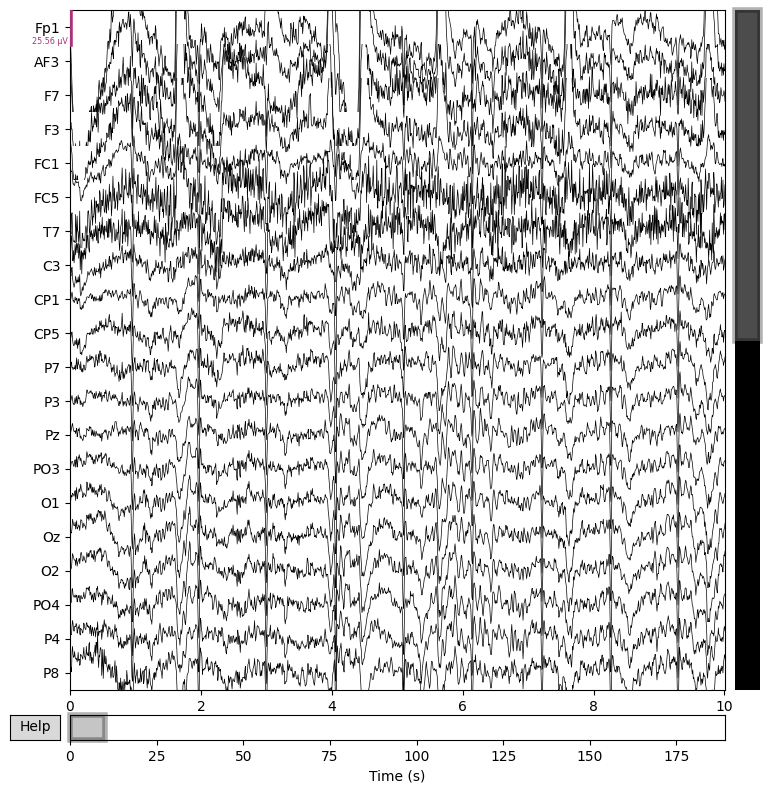

Loading and plotting preprocessed file: /content/preprocessed_data/Healthy/sub-hc24_ses-hc_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Healthy/sub-hc24_ses-hc_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 24575 =      0.000 ...   191.992 secs
Ready.
Reading 0 ... 24575  =      0.000 ...   191.992 secs...


<ipython-input-43-307b17ca18d5>:14: RuntimeWarning: This filename (/content/preprocessed_data/Healthy/sub-hc24_ses-hc_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)


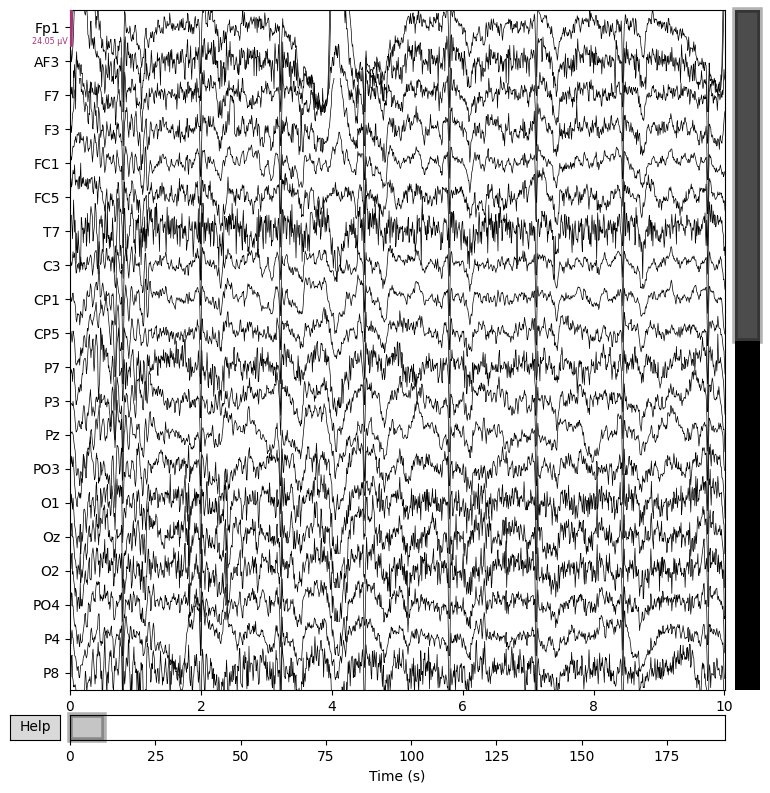

Loading and plotting preprocessed file: /content/preprocessed_data/Healthy/sub-hc1_ses-hc_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Healthy/sub-hc1_ses-hc_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 24575 =      0.000 ...   191.992 secs
Ready.
Reading 0 ... 24575  =      0.000 ...   191.992 secs...


<ipython-input-43-307b17ca18d5>:14: RuntimeWarning: This filename (/content/preprocessed_data/Healthy/sub-hc1_ses-hc_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)


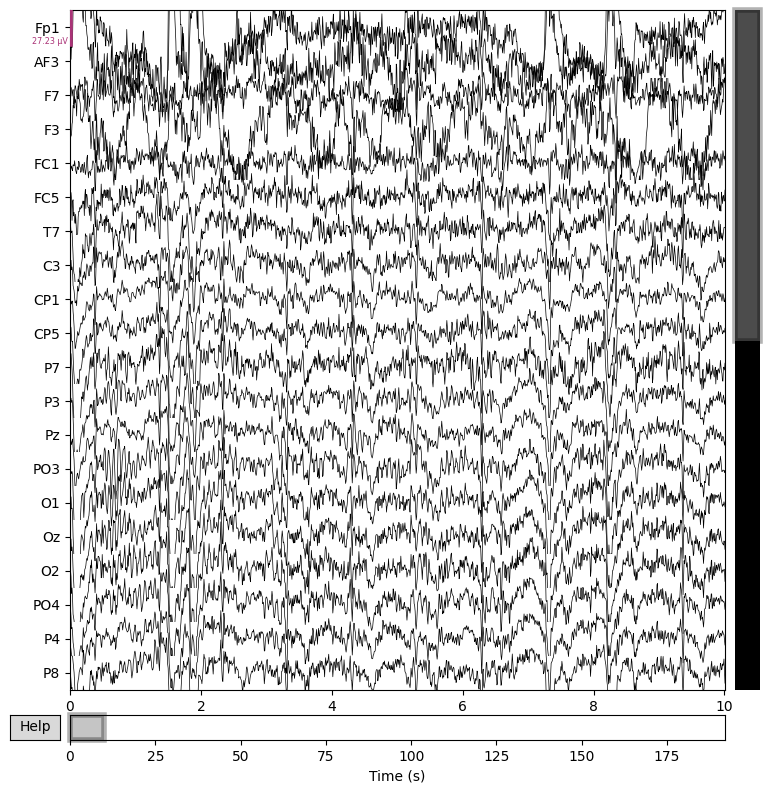

Loading and plotting preprocessed file: /content/preprocessed_data/Healthy/sub-hc31_ses-hc_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Healthy/sub-hc31_ses-hc_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 23935 =      0.000 ...   186.992 secs
Ready.
Reading 0 ... 23935  =      0.000 ...   186.992 secs...


<ipython-input-43-307b17ca18d5>:14: RuntimeWarning: This filename (/content/preprocessed_data/Healthy/sub-hc31_ses-hc_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)


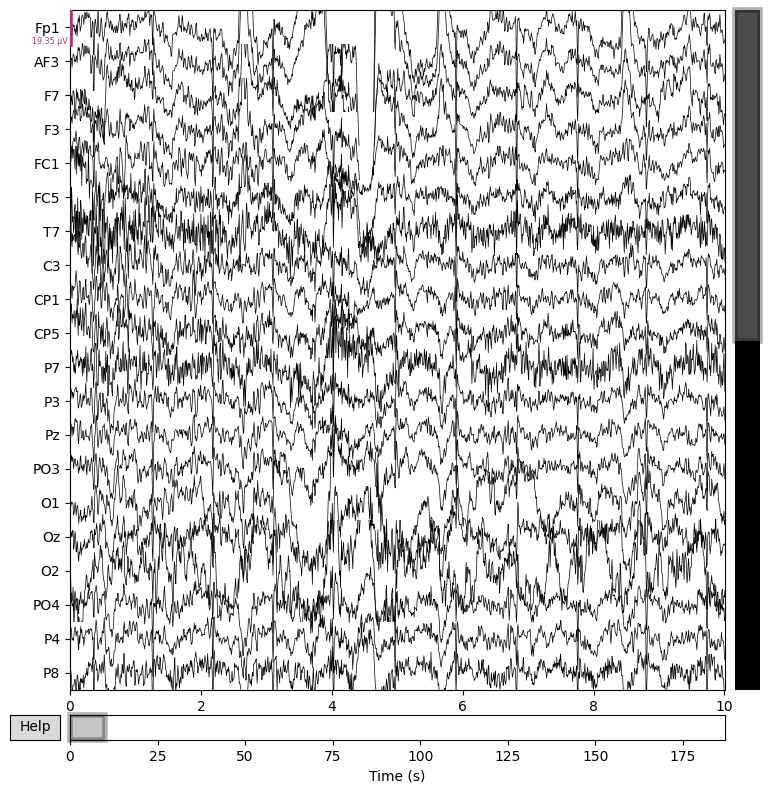

Loading and plotting preprocessed file: /content/preprocessed_data/Healthy/sub-hc8_ses-hc_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Healthy/sub-hc8_ses-hc_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 24447 =      0.000 ...   190.992 secs
Ready.
Reading 0 ... 24447  =      0.000 ...   190.992 secs...


<ipython-input-43-307b17ca18d5>:14: RuntimeWarning: This filename (/content/preprocessed_data/Healthy/sub-hc8_ses-hc_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)


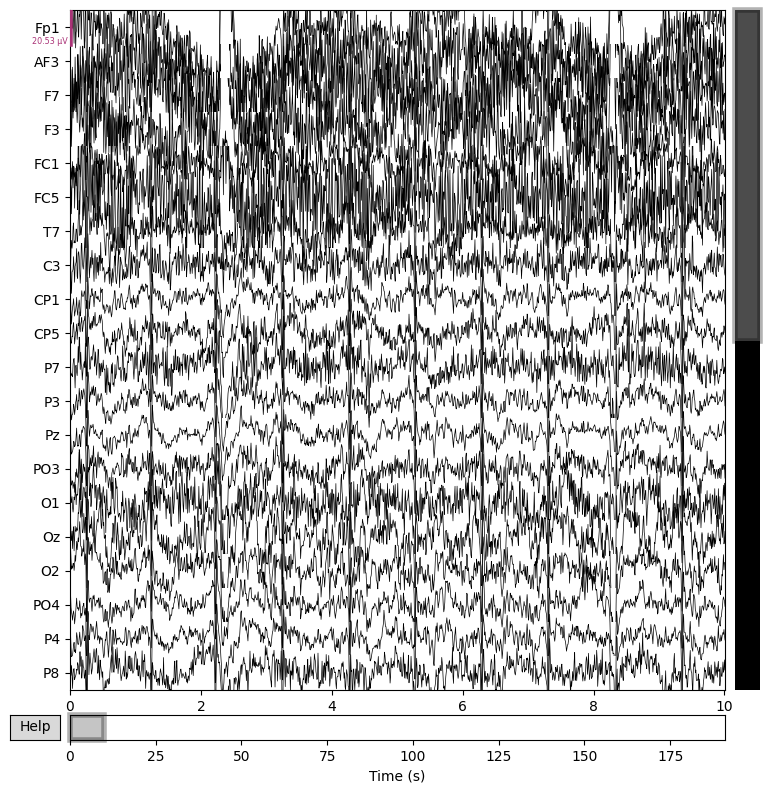

Loading and plotting preprocessed file: /content/preprocessed_data/Healthy/sub-hc2_ses-hc_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Healthy/sub-hc2_ses-hc_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 24831 =      0.000 ...   193.992 secs
Ready.
Reading 0 ... 24831  =      0.000 ...   193.992 secs...


<ipython-input-43-307b17ca18d5>:14: RuntimeWarning: This filename (/content/preprocessed_data/Healthy/sub-hc2_ses-hc_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)


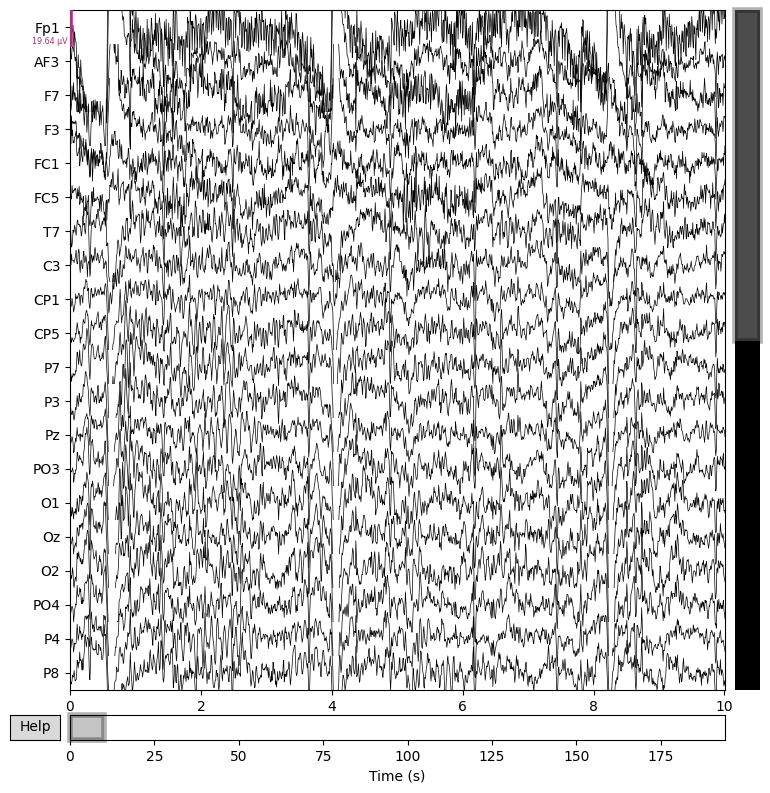

Loading and plotting preprocessed file: /content/preprocessed_data/Healthy/sub-hc32_ses-hc_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Healthy/sub-hc32_ses-hc_task-rest_eeg-preprocessed.fif...
Isotrak not found


<ipython-input-43-307b17ca18d5>:14: RuntimeWarning: This filename (/content/preprocessed_data/Healthy/sub-hc32_ses-hc_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)


    Range : 0 ... 25087 =      0.000 ...   195.992 secs
Ready.
Reading 0 ... 25087  =      0.000 ...   195.992 secs...


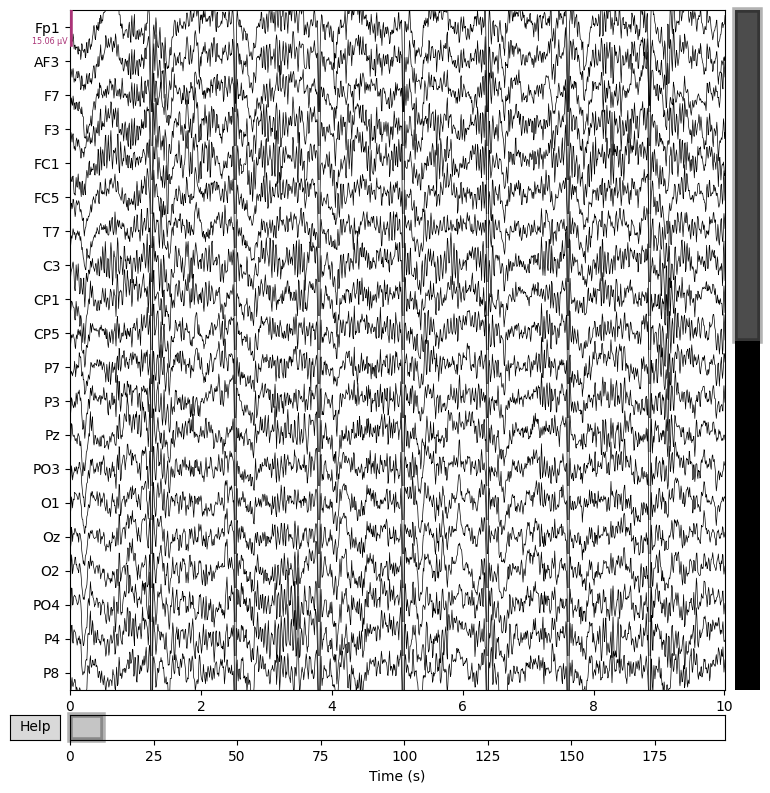

Loading and plotting preprocessed file: /content/preprocessed_data/Healthy/sub-hc33_ses-hc_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Healthy/sub-hc33_ses-hc_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 24319 =      0.000 ...   189.992 secs
Ready.
Reading 0 ... 24319  =      0.000 ...   189.992 secs...


<ipython-input-43-307b17ca18d5>:14: RuntimeWarning: This filename (/content/preprocessed_data/Healthy/sub-hc33_ses-hc_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)


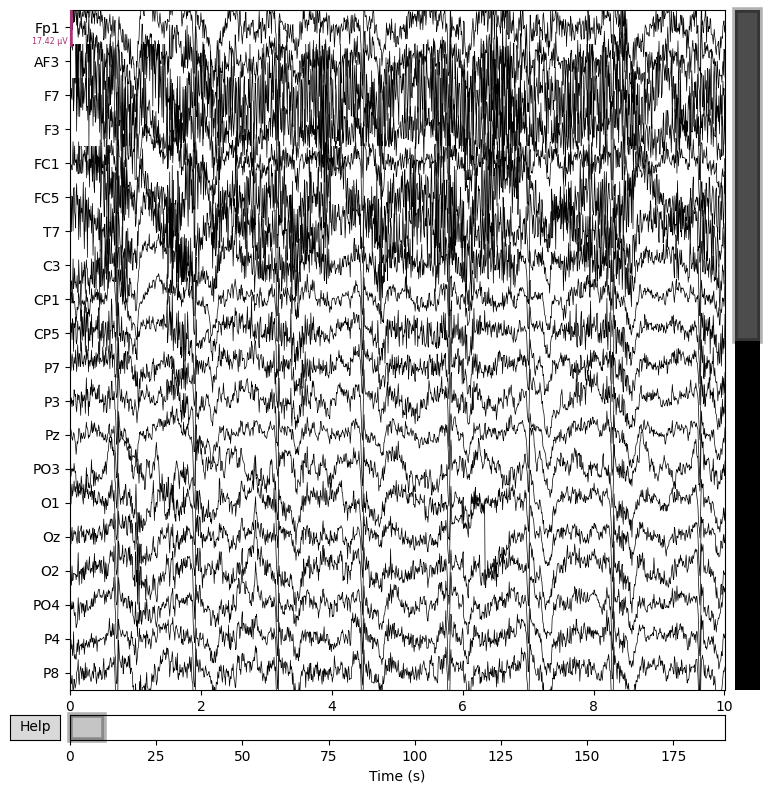

Loading and plotting preprocessed file: /content/preprocessed_data/Healthy/sub-hc20_ses-hc_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Healthy/sub-hc20_ses-hc_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 23551 =      0.000 ...   183.992 secs
Ready.
Reading 0 ... 23551  =      0.000 ...   183.992 secs...


<ipython-input-43-307b17ca18d5>:14: RuntimeWarning: This filename (/content/preprocessed_data/Healthy/sub-hc20_ses-hc_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)


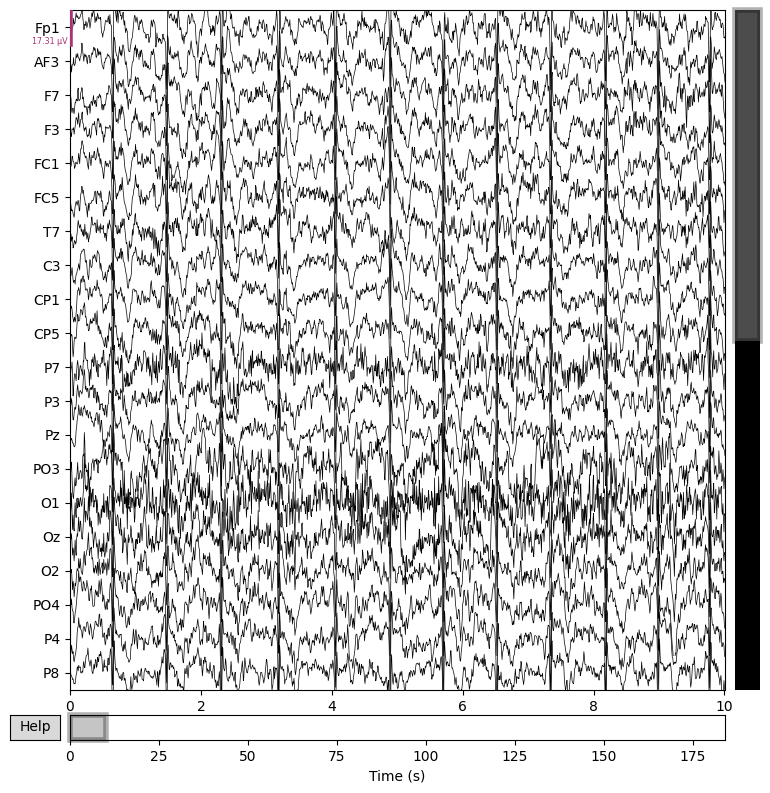

Loading and plotting preprocessed file: /content/preprocessed_data/Healthy/sub-hc30_ses-hc_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Healthy/sub-hc30_ses-hc_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 24191 =      0.000 ...   188.992 secs
Ready.
Reading 0 ... 24191  =      0.000 ...   188.992 secs...


<ipython-input-43-307b17ca18d5>:14: RuntimeWarning: This filename (/content/preprocessed_data/Healthy/sub-hc30_ses-hc_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)


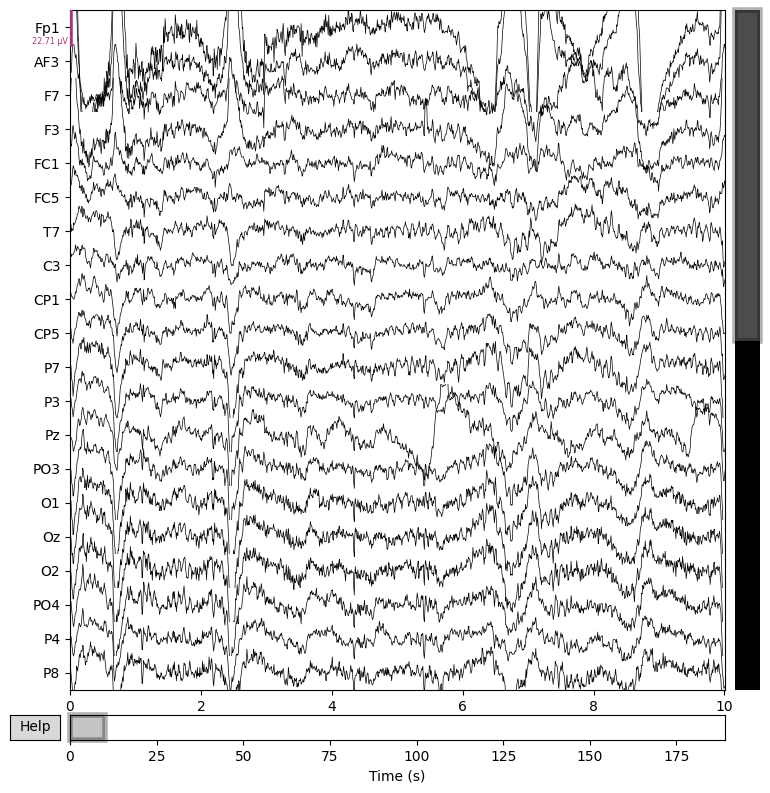

Loading and plotting preprocessed file: /content/preprocessed_data/Healthy/sub-hc29_ses-hc_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Healthy/sub-hc29_ses-hc_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 25471 =      0.000 ...   198.992 secs
Ready.
Reading 0 ... 25471  =      0.000 ...   198.992 secs...


<ipython-input-43-307b17ca18d5>:14: RuntimeWarning: This filename (/content/preprocessed_data/Healthy/sub-hc29_ses-hc_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)


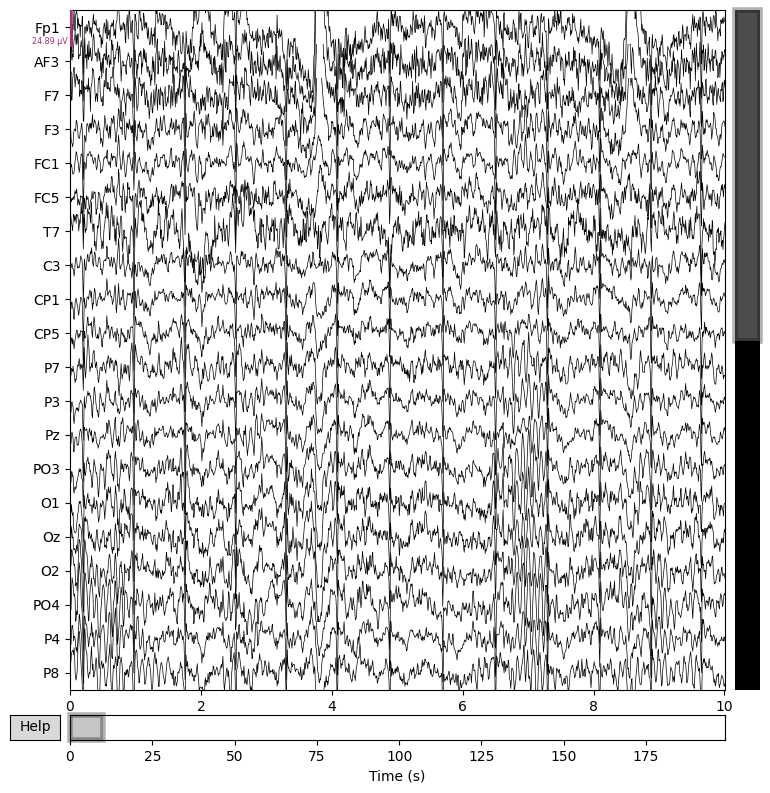

Loading and plotting preprocessed file: /content/preprocessed_data/Healthy/sub-hc4_ses-hc_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Healthy/sub-hc4_ses-hc_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 23167 =      0.000 ...   180.992 secs
Ready.
Reading 0 ... 23167  =      0.000 ...   180.992 secs...


<ipython-input-43-307b17ca18d5>:14: RuntimeWarning: This filename (/content/preprocessed_data/Healthy/sub-hc4_ses-hc_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)


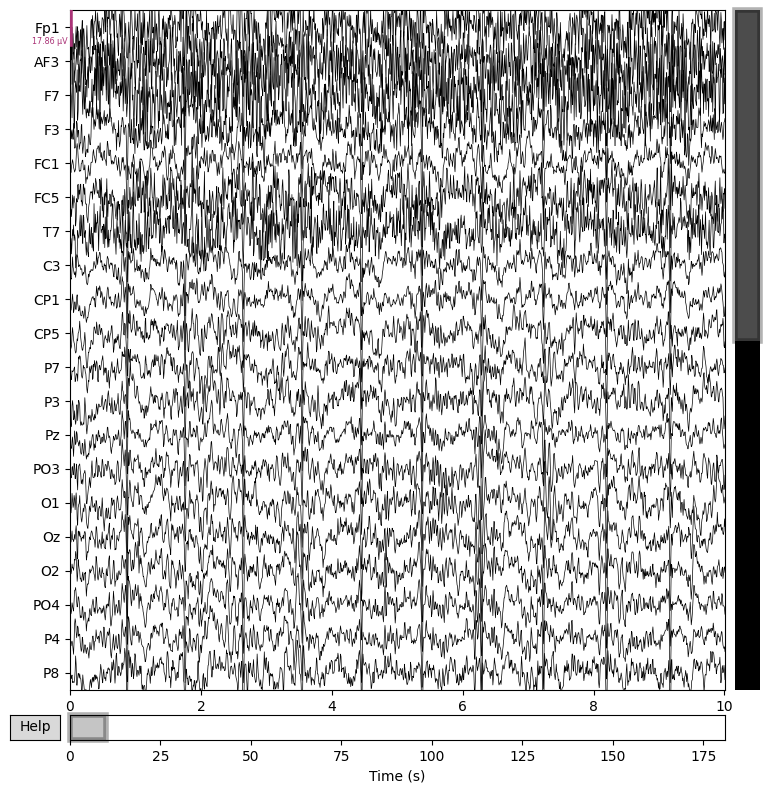

Loading and plotting preprocessed file: /content/preprocessed_data/Healthy/sub-hc10_ses-hc_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Healthy/sub-hc10_ses-hc_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 25727 =      0.000 ...   200.992 secs
Ready.
Reading 0 ... 25727  =      0.000 ...   200.992 secs...


<ipython-input-43-307b17ca18d5>:14: RuntimeWarning: This filename (/content/preprocessed_data/Healthy/sub-hc10_ses-hc_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)


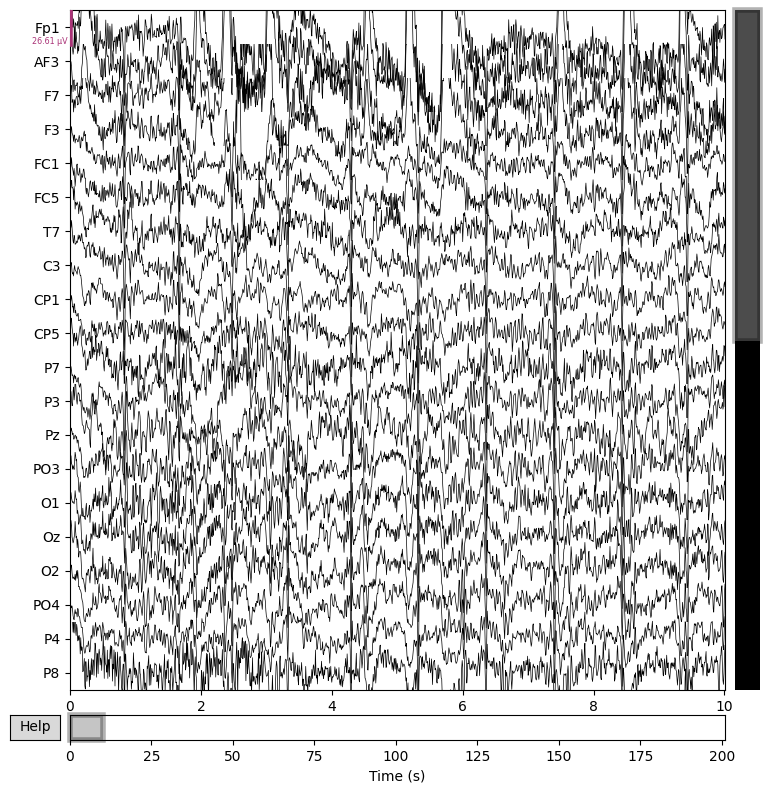

Loading and plotting preprocessed file: /content/preprocessed_data/Healthy/sub-hc25_ses-hc_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Healthy/sub-hc25_ses-hc_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 25855 =      0.000 ...   201.992 secs
Ready.
Reading 0 ... 25855  =      0.000 ...   201.992 secs...


<ipython-input-43-307b17ca18d5>:14: RuntimeWarning: This filename (/content/preprocessed_data/Healthy/sub-hc25_ses-hc_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)


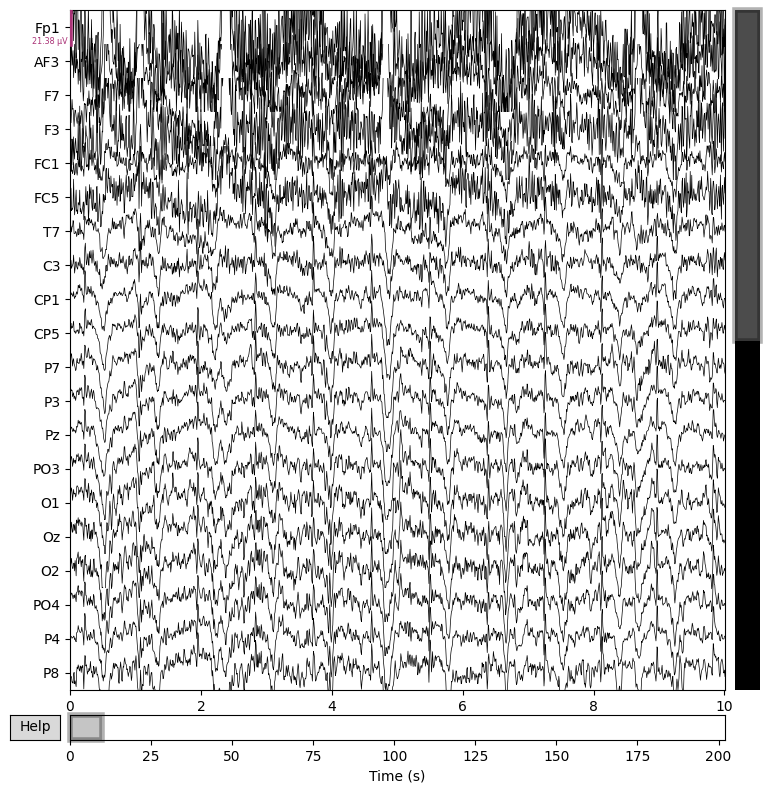

Loading and plotting preprocessed file: /content/preprocessed_data/Healthy/sub-hc18_ses-hc_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Healthy/sub-hc18_ses-hc_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 23807 =      0.000 ...   185.992 secs
Ready.
Reading 0 ... 23807  =      0.000 ...   185.992 secs...


<ipython-input-43-307b17ca18d5>:14: RuntimeWarning: This filename (/content/preprocessed_data/Healthy/sub-hc18_ses-hc_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)


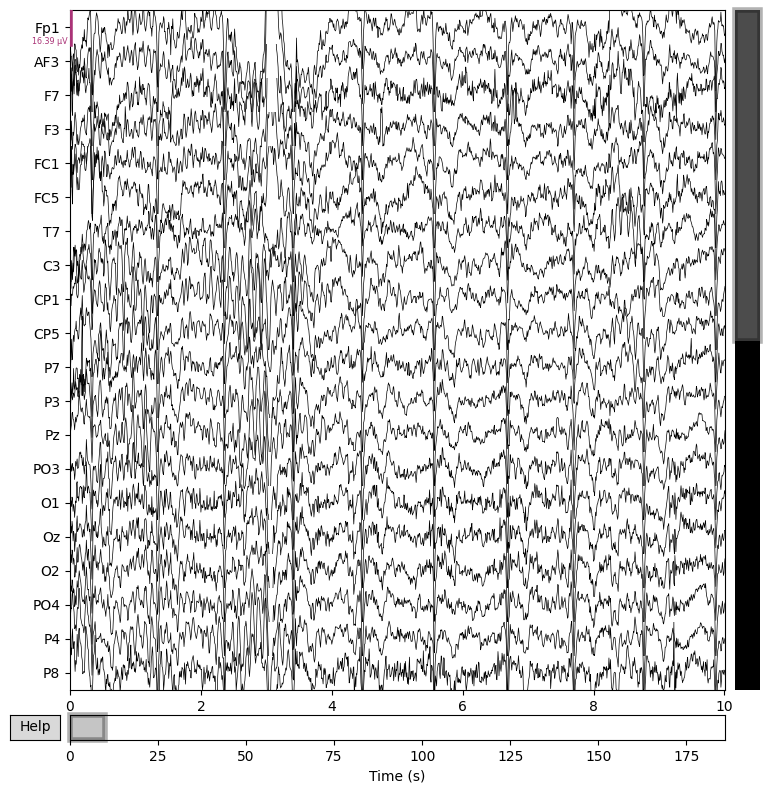

Loading and plotting preprocessed file: /content/preprocessed_data/Healthy/sub-hc7_ses-hc_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Healthy/sub-hc7_ses-hc_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 24575 =      0.000 ...   191.992 secs
Ready.
Reading 0 ... 24575  =      0.000 ...   191.992 secs...


<ipython-input-43-307b17ca18d5>:14: RuntimeWarning: This filename (/content/preprocessed_data/Healthy/sub-hc7_ses-hc_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)


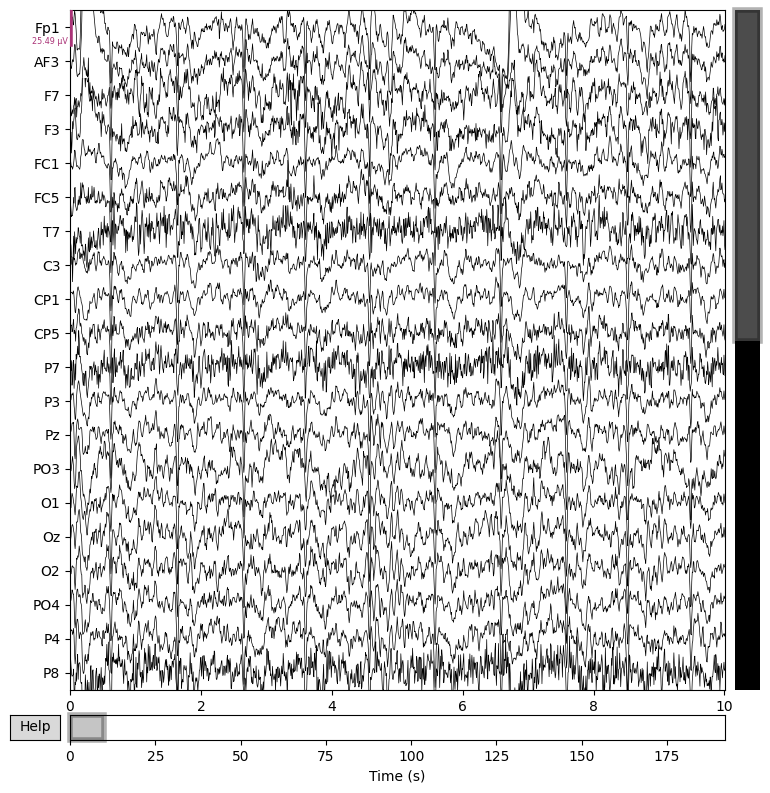

In [44]:
# Plot preprocessed data from Healthy folder
print("Plotting Healthy Preprocessed Files...")
plot_preprocessed_data(preprocessed_healthy_folder)



Plotting Parkinson Preprocessed Files...
Loading and plotting preprocessed file: /content/preprocessed_data/Parkinson/sub-pd19_ses-on_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Parkinson/sub-pd19_ses-on_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 24063 =      0.000 ...   187.992 secs
Ready.
Reading 0 ... 24063  =      0.000 ...   187.992 secs...


<ipython-input-43-307b17ca18d5>:14: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd19_ses-on_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)


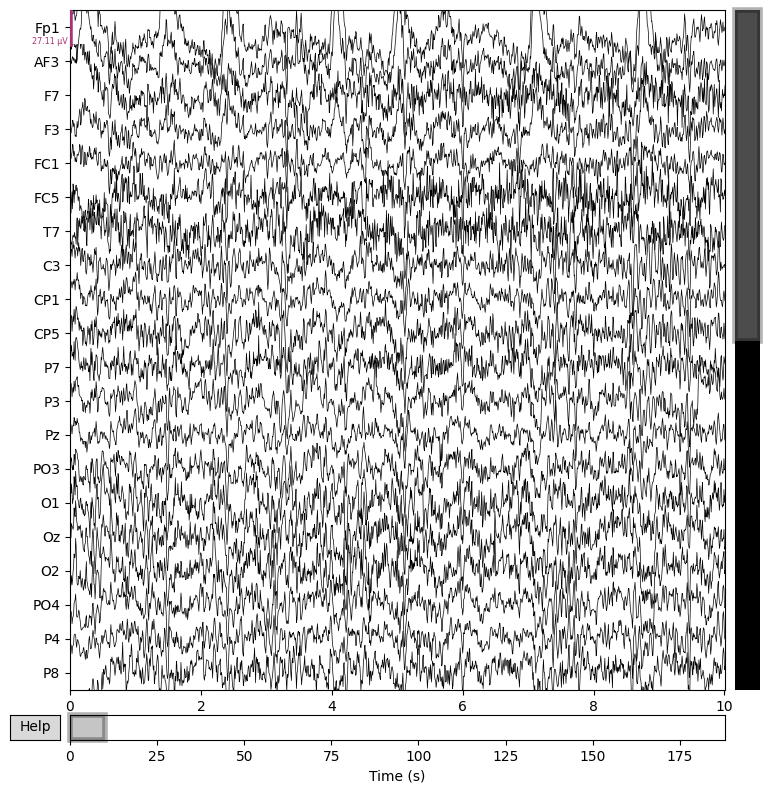

Loading and plotting preprocessed file: /content/preprocessed_data/Parkinson/sub-pd22_ses-on_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Parkinson/sub-pd22_ses-on_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 23551 =      0.000 ...   183.992 secs
Ready.
Reading 0 ... 23551  =      0.000 ...   183.992 secs...


<ipython-input-43-307b17ca18d5>:14: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd22_ses-on_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)


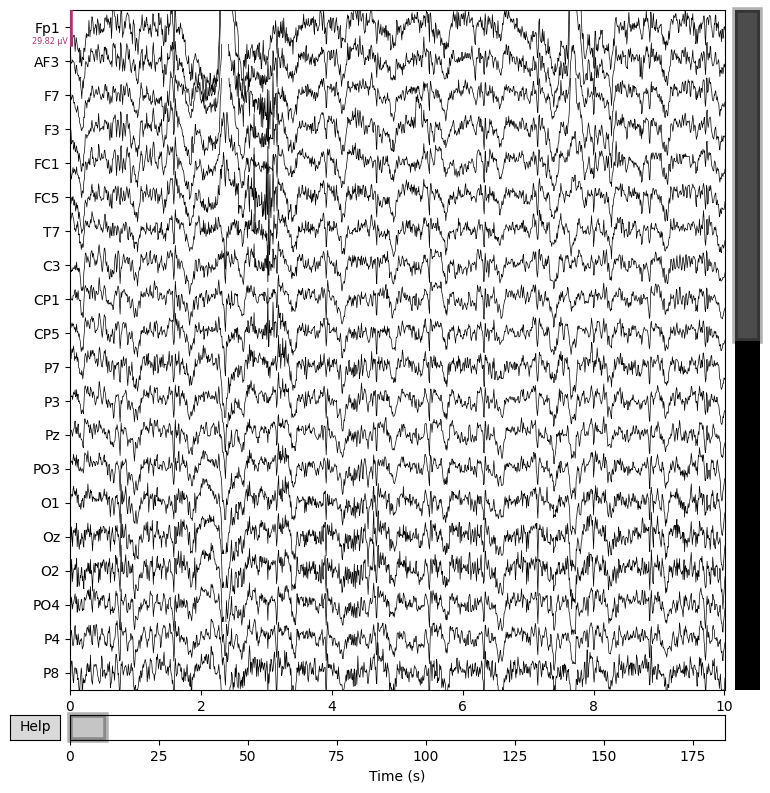

Loading and plotting preprocessed file: /content/preprocessed_data/Parkinson/sub-pd13_ses-on_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Parkinson/sub-pd13_ses-on_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 23935 =      0.000 ...   186.992 secs
Ready.
Reading 0 ... 23935  =      0.000 ...   186.992 secs...


<ipython-input-43-307b17ca18d5>:14: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd13_ses-on_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)


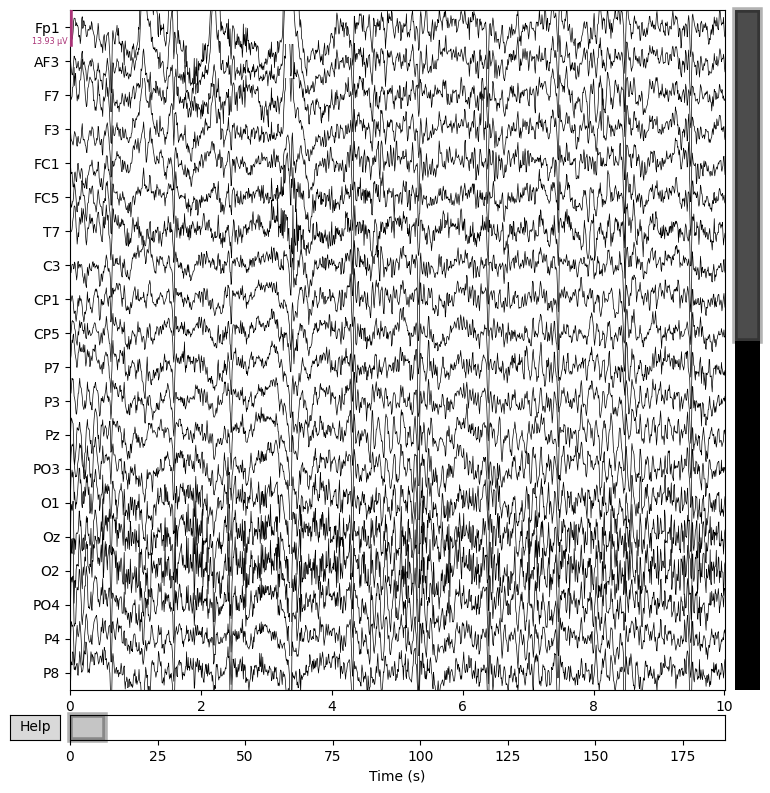

Loading and plotting preprocessed file: /content/preprocessed_data/Parkinson/sub-pd3_ses-on_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Parkinson/sub-pd3_ses-on_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 27263 =      0.000 ...   212.992 secs
Ready.
Reading 0 ... 27263  =      0.000 ...   212.992 secs...


<ipython-input-43-307b17ca18d5>:14: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd3_ses-on_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)


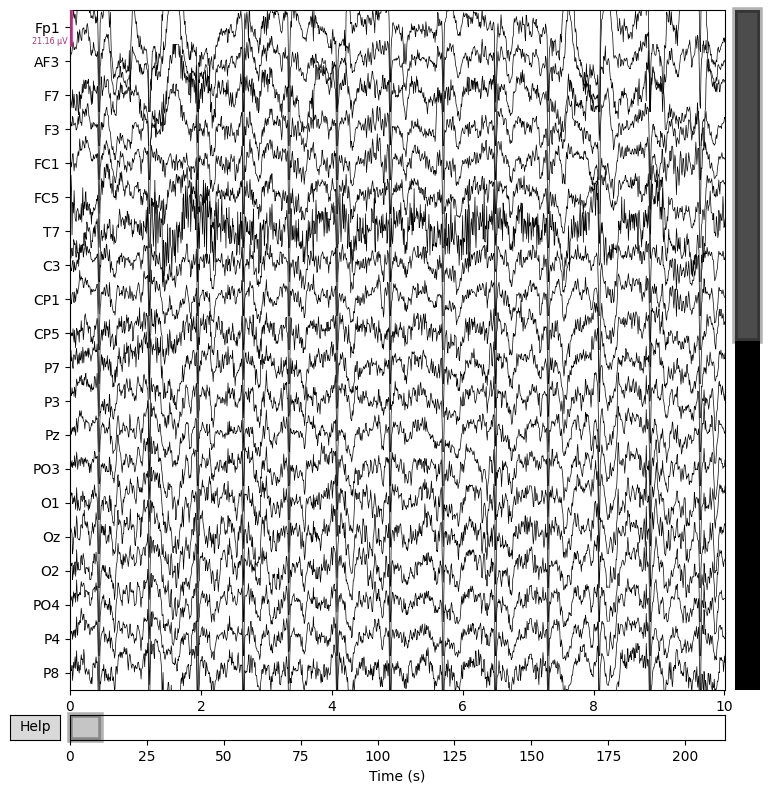

Loading and plotting preprocessed file: /content/preprocessed_data/Parkinson/sub-pd22_ses-off_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Parkinson/sub-pd22_ses-off_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 24063 =      0.000 ...   187.992 secs
Ready.
Reading 0 ... 24063  =      0.000 ...   187.992 secs...


<ipython-input-43-307b17ca18d5>:14: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd22_ses-off_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)


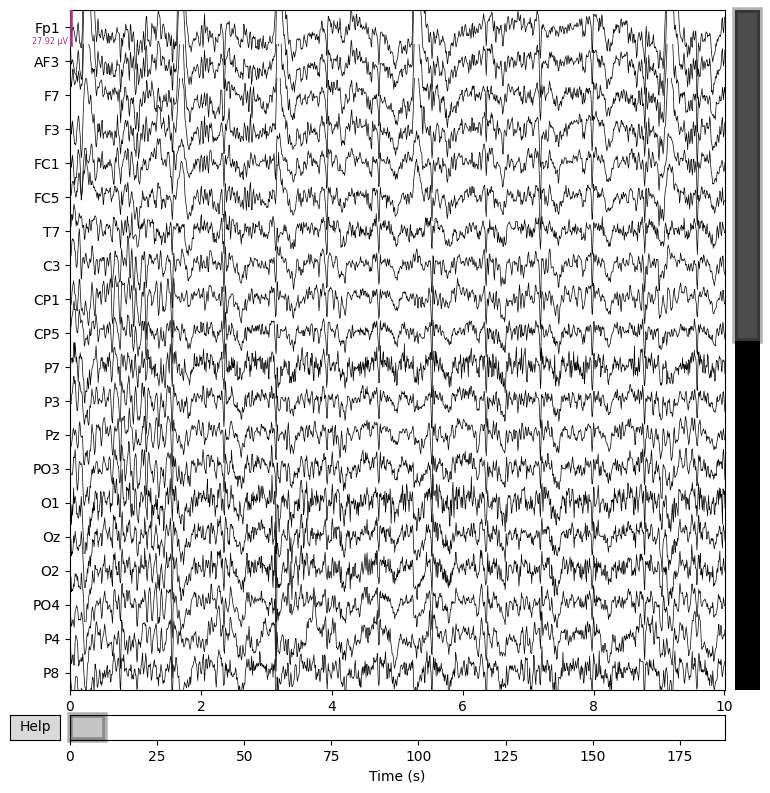

Loading and plotting preprocessed file: /content/preprocessed_data/Parkinson/sub-pd23_ses-on_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Parkinson/sub-pd23_ses-on_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 23807 =      0.000 ...   185.992 secs
Ready.
Reading 0 ... 23807  =      0.000 ...   185.992 secs...


<ipython-input-43-307b17ca18d5>:14: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd23_ses-on_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)


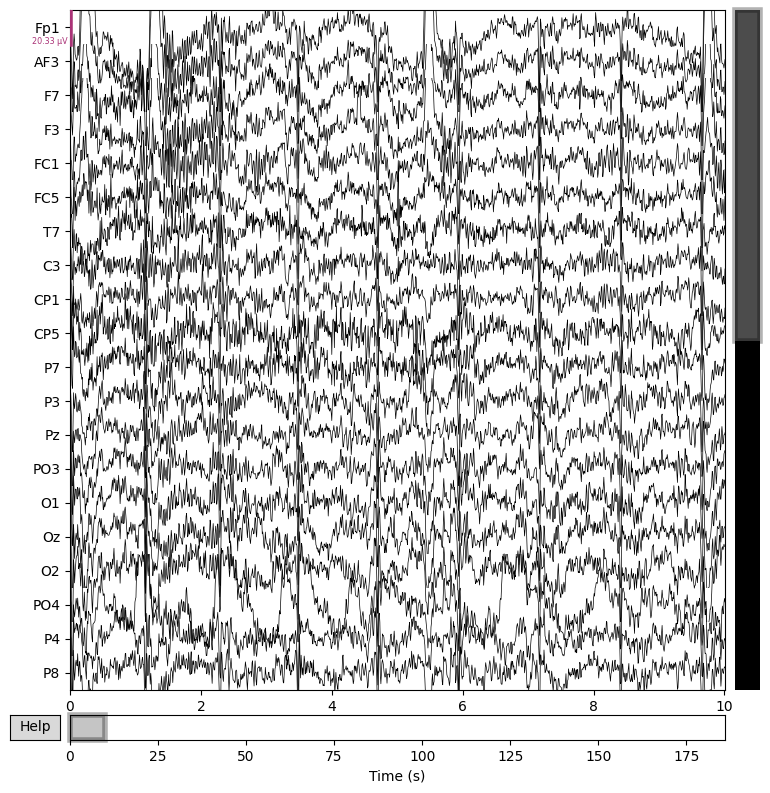

Loading and plotting preprocessed file: /content/preprocessed_data/Parkinson/sub-pd11_ses-off_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Parkinson/sub-pd11_ses-off_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 23807 =      0.000 ...   185.992 secs
Ready.
Reading 0 ... 23807  =      0.000 ...   185.992 secs...


<ipython-input-43-307b17ca18d5>:14: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd11_ses-off_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)


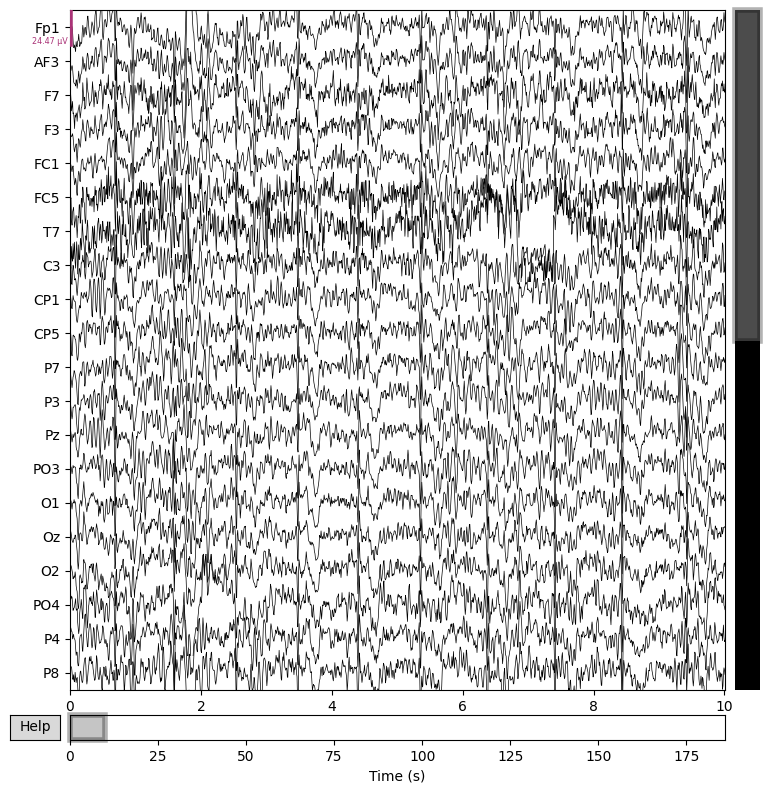

Loading and plotting preprocessed file: /content/preprocessed_data/Parkinson/sub-pd9_ses-on_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Parkinson/sub-pd9_ses-on_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 23935 =      0.000 ...   186.992 secs
Ready.
Reading 0 ... 23935  =      0.000 ...   186.992 secs...


<ipython-input-43-307b17ca18d5>:14: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd9_ses-on_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)


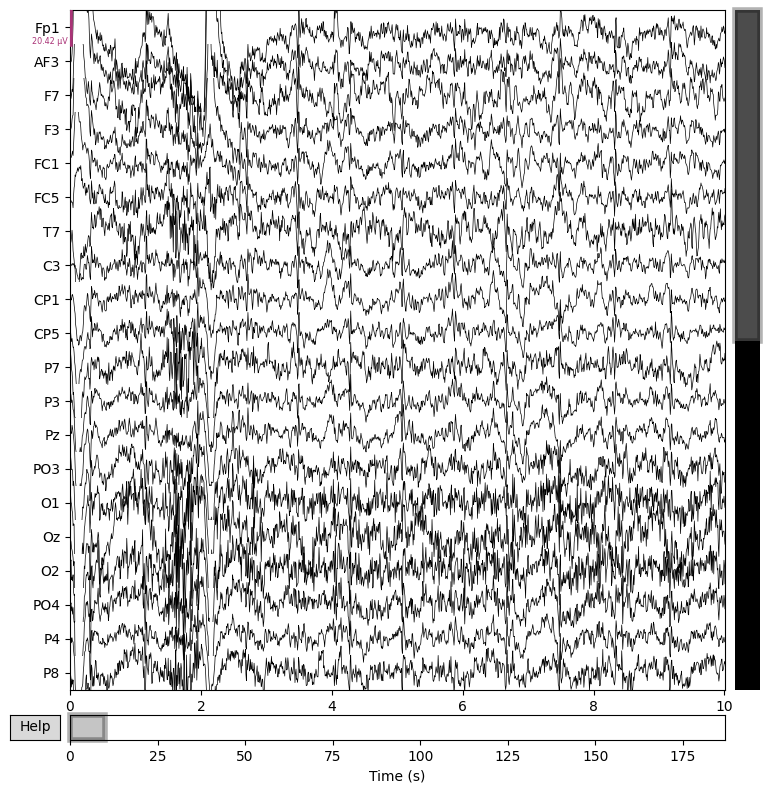

Loading and plotting preprocessed file: /content/preprocessed_data/Parkinson/sub-pd12_ses-on_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Parkinson/sub-pd12_ses-on_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 24575 =      0.000 ...   191.992 secs
Ready.
Reading 0 ... 24575  =      0.000 ...   191.992 secs...


<ipython-input-43-307b17ca18d5>:14: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd12_ses-on_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)


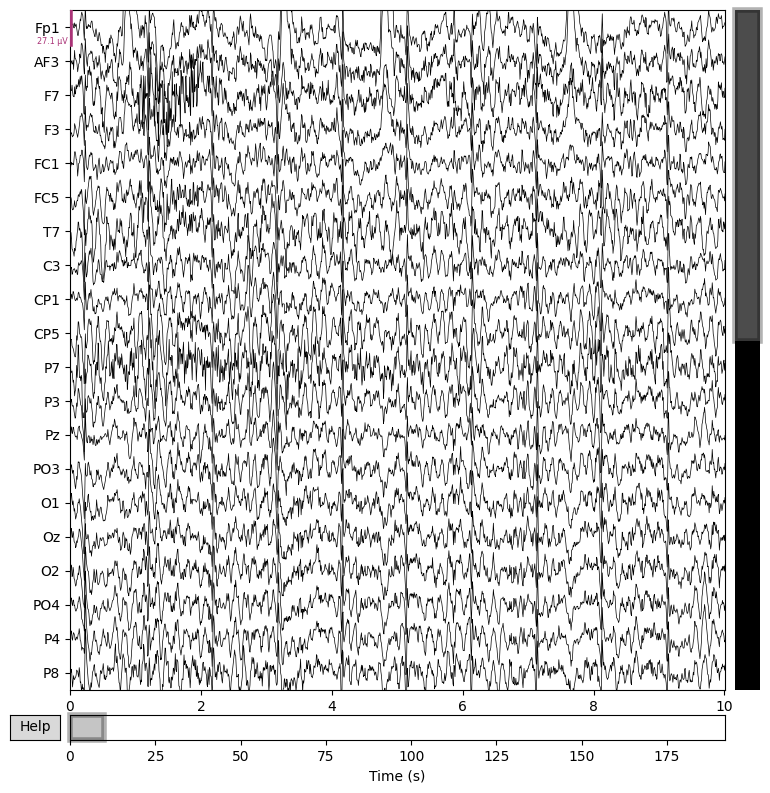

Loading and plotting preprocessed file: /content/preprocessed_data/Parkinson/sub-pd14_ses-on_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Parkinson/sub-pd14_ses-on_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 24191 =      0.000 ...   188.992 secs
Ready.
Reading 0 ... 24191  =      0.000 ...   188.992 secs...


<ipython-input-43-307b17ca18d5>:14: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd14_ses-on_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)


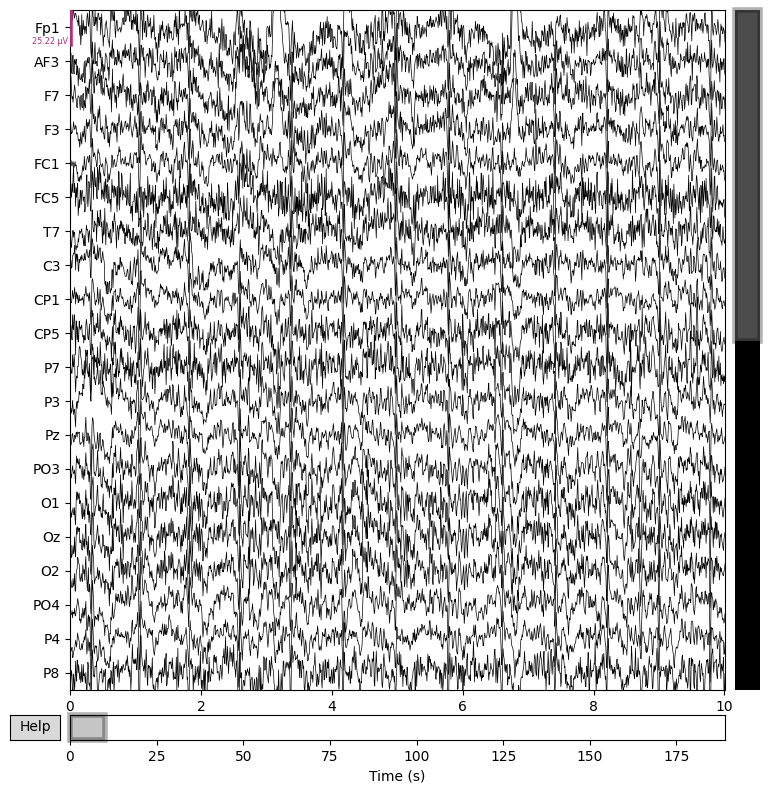

Loading and plotting preprocessed file: /content/preprocessed_data/Parkinson/sub-pd3_ses-off_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Parkinson/sub-pd3_ses-off_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 25599 =      0.000 ...   199.992 secs
Ready.
Reading 0 ... 25599  =      0.000 ...   199.992 secs...


<ipython-input-43-307b17ca18d5>:14: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd3_ses-off_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)


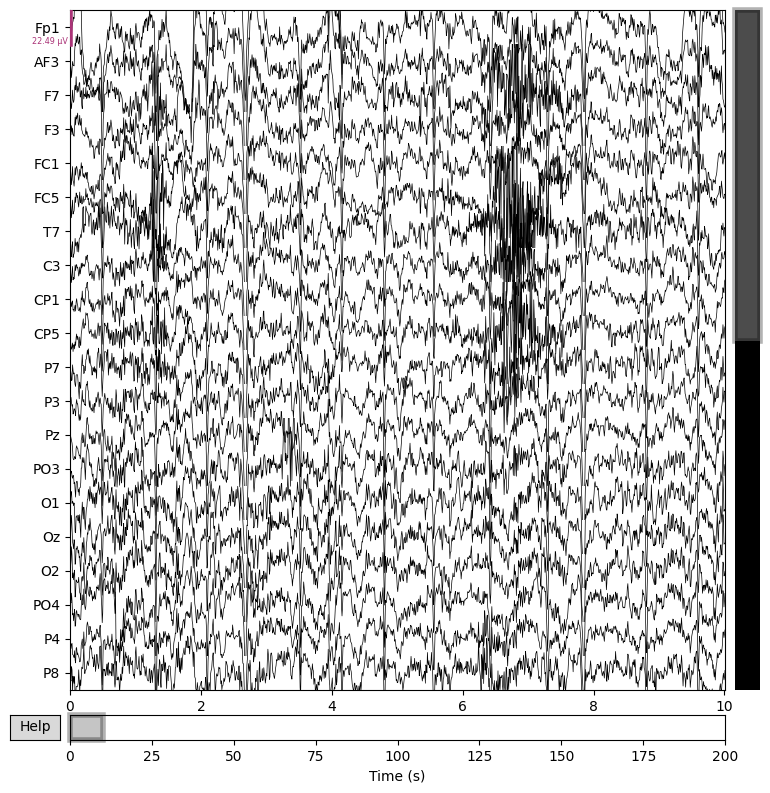

Loading and plotting preprocessed file: /content/preprocessed_data/Parkinson/sub-pd26_ses-off_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Parkinson/sub-pd26_ses-off_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 24447 =      0.000 ...   190.992 secs
Ready.
Reading 0 ... 24447  =      0.000 ...   190.992 secs...


<ipython-input-43-307b17ca18d5>:14: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd26_ses-off_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)


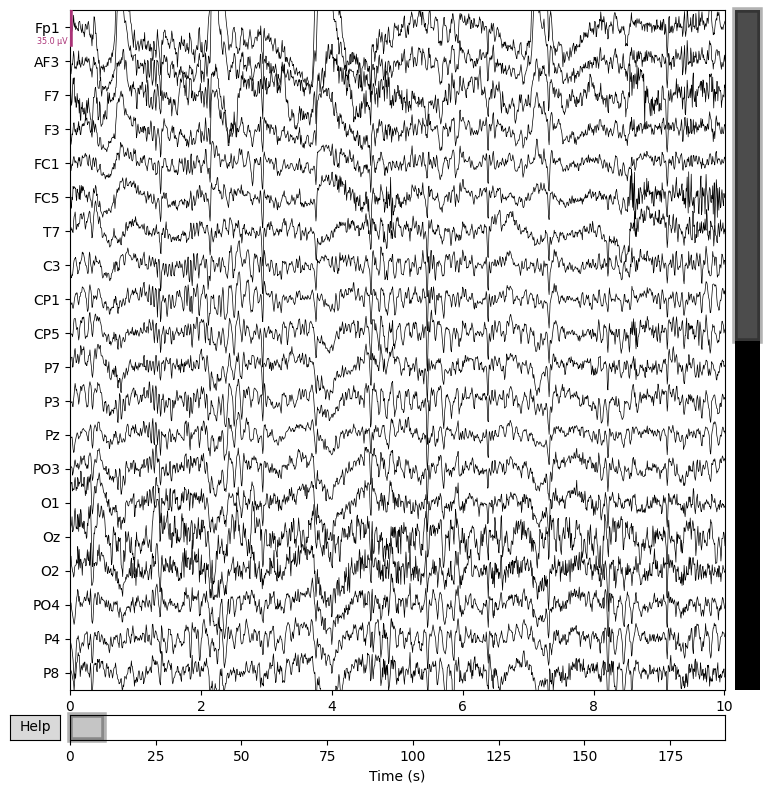

Loading and plotting preprocessed file: /content/preprocessed_data/Parkinson/sub-pd13_ses-off_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Parkinson/sub-pd13_ses-off_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 23807 =      0.000 ...   185.992 secs
Ready.
Reading 0 ... 23807  =      0.000 ...   185.992 secs...


<ipython-input-43-307b17ca18d5>:14: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd13_ses-off_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)


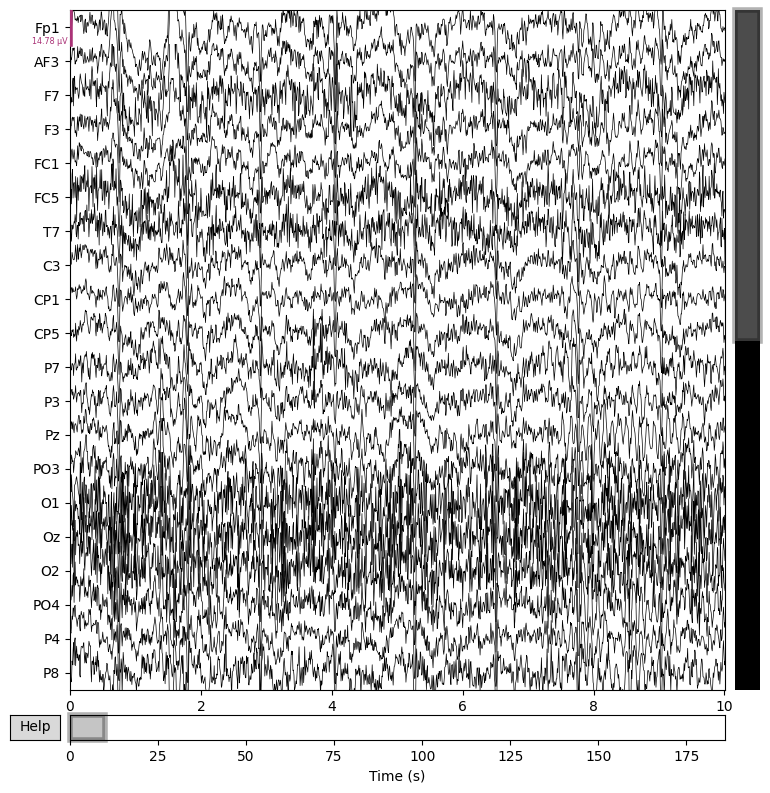

Loading and plotting preprocessed file: /content/preprocessed_data/Parkinson/sub-pd19_ses-off_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Parkinson/sub-pd19_ses-off_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 23679 =      0.000 ...   184.992 secs
Ready.
Reading 0 ... 23679  =      0.000 ...   184.992 secs...


<ipython-input-43-307b17ca18d5>:14: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd19_ses-off_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)


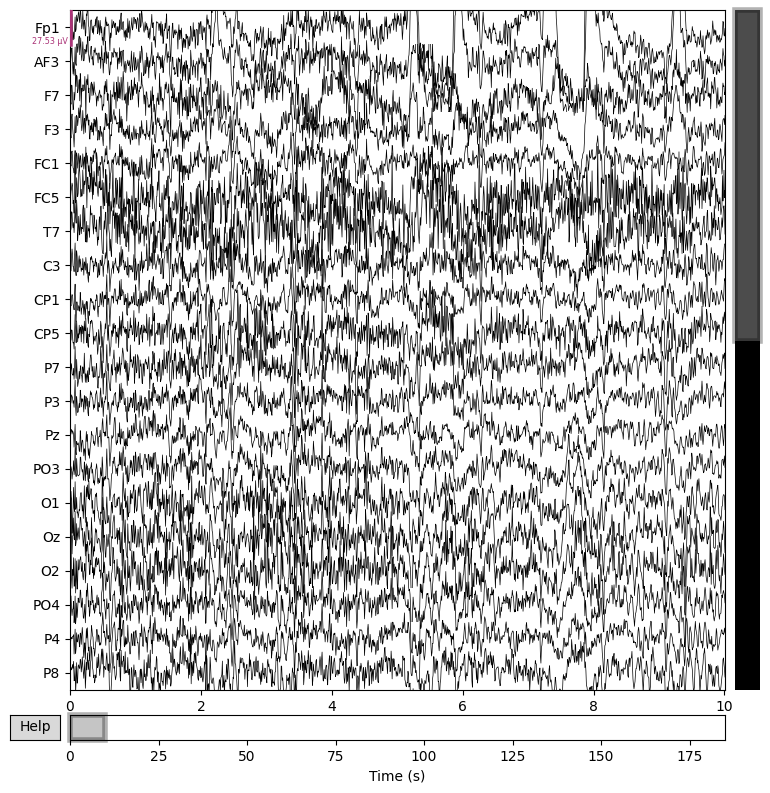

Loading and plotting preprocessed file: /content/preprocessed_data/Parkinson/sub-pd16_ses-on_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Parkinson/sub-pd16_ses-on_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 23935 =      0.000 ...   186.992 secs
Ready.
Reading 0 ... 23935  =      0.000 ...   186.992 secs...


<ipython-input-43-307b17ca18d5>:14: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd16_ses-on_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)


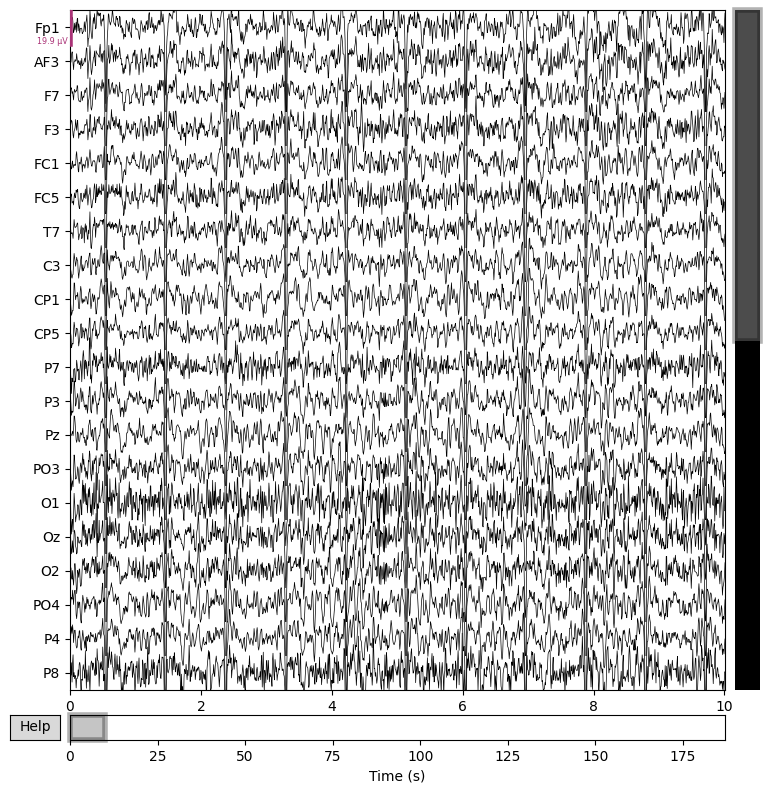

Loading and plotting preprocessed file: /content/preprocessed_data/Parkinson/sub-pd6_ses-off_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Parkinson/sub-pd6_ses-off_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 24447 =      0.000 ...   190.992 secs
Ready.
Reading 0 ... 24447  =      0.000 ...   190.992 secs...


<ipython-input-43-307b17ca18d5>:14: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd6_ses-off_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)


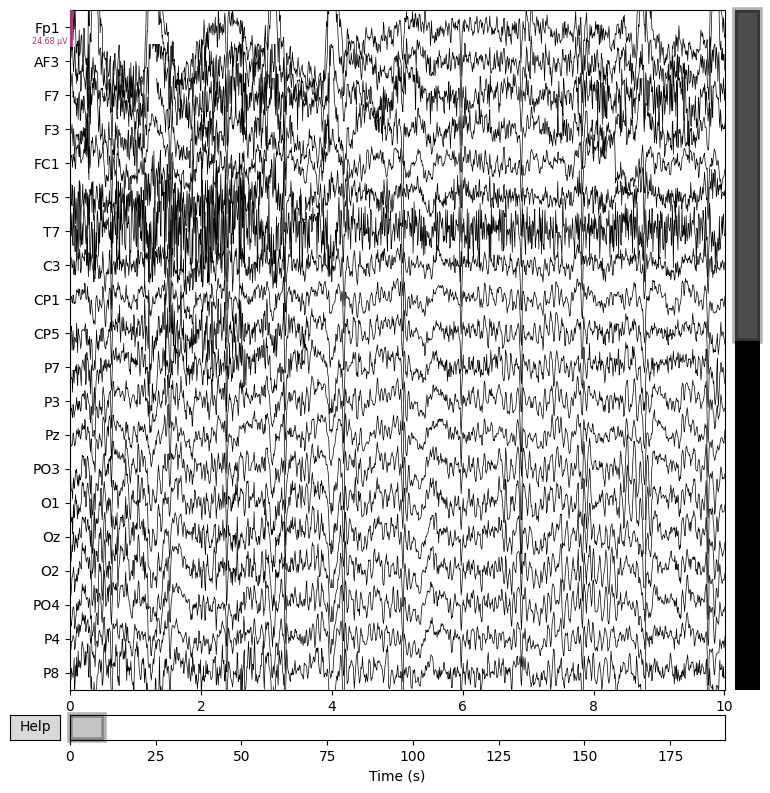

Loading and plotting preprocessed file: /content/preprocessed_data/Parkinson/sub-pd11_ses-on_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Parkinson/sub-pd11_ses-on_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 23935 =      0.000 ...   186.992 secs
Ready.
Reading 0 ... 23935  =      0.000 ...   186.992 secs...


<ipython-input-43-307b17ca18d5>:14: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd11_ses-on_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)


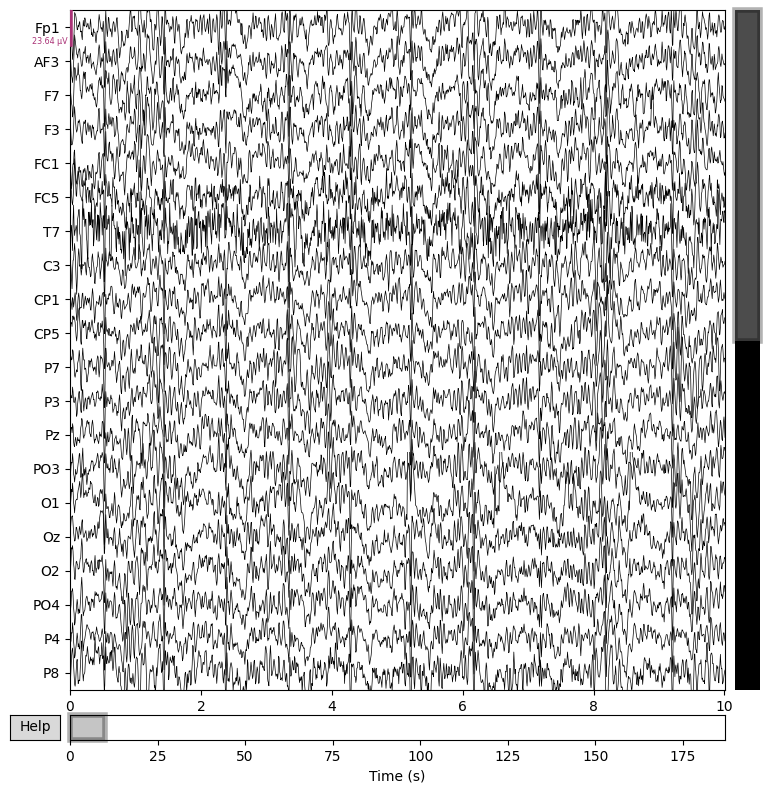

Loading and plotting preprocessed file: /content/preprocessed_data/Parkinson/sub-pd17_ses-on_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Parkinson/sub-pd17_ses-on_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 23807 =      0.000 ...   185.992 secs
Ready.
Reading 0 ... 23807  =      0.000 ...   185.992 secs...


<ipython-input-43-307b17ca18d5>:14: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd17_ses-on_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)


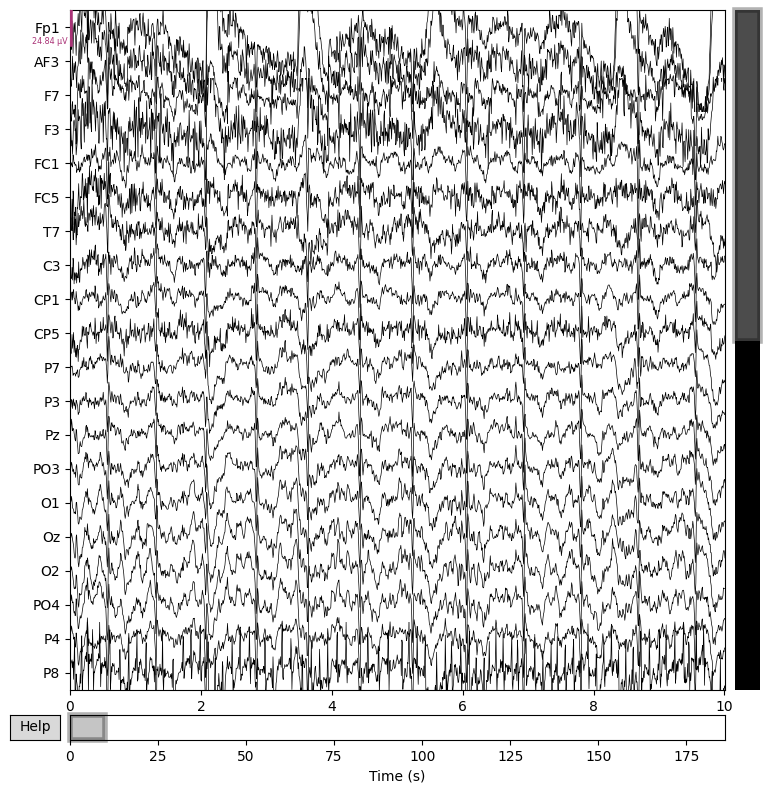

Loading and plotting preprocessed file: /content/preprocessed_data/Parkinson/sub-pd14_ses-off_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Parkinson/sub-pd14_ses-off_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 37375 =      0.000 ...   291.992 secs
Ready.
Reading 0 ... 37375  =      0.000 ...   291.992 secs...


<ipython-input-43-307b17ca18d5>:14: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd14_ses-off_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)


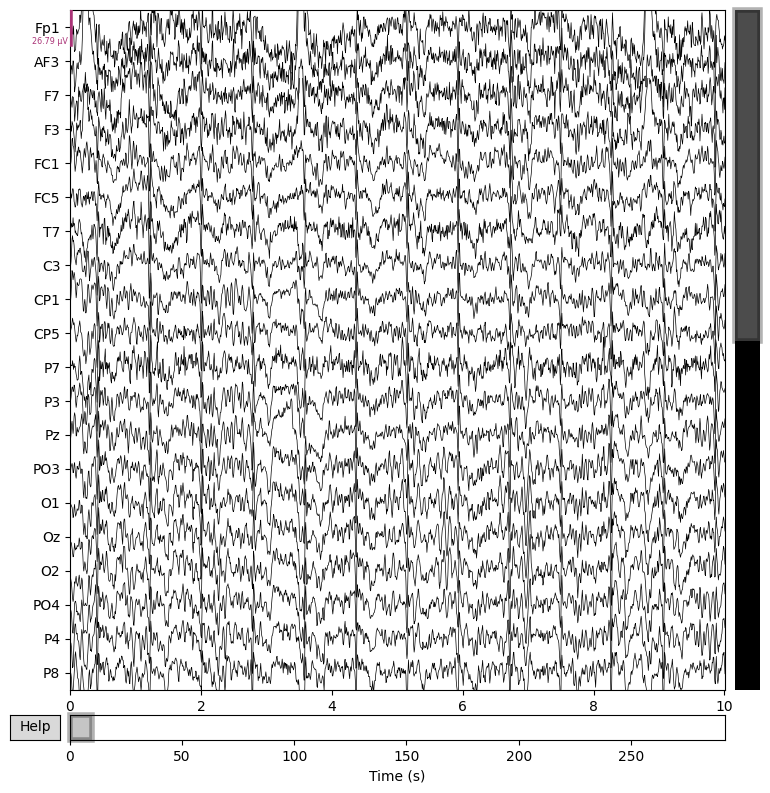

Loading and plotting preprocessed file: /content/preprocessed_data/Parkinson/sub-pd17_ses-off_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Parkinson/sub-pd17_ses-off_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 24191 =      0.000 ...   188.992 secs
Ready.
Reading 0 ... 24191  =      0.000 ...   188.992 secs...


<ipython-input-43-307b17ca18d5>:14: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd17_ses-off_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)


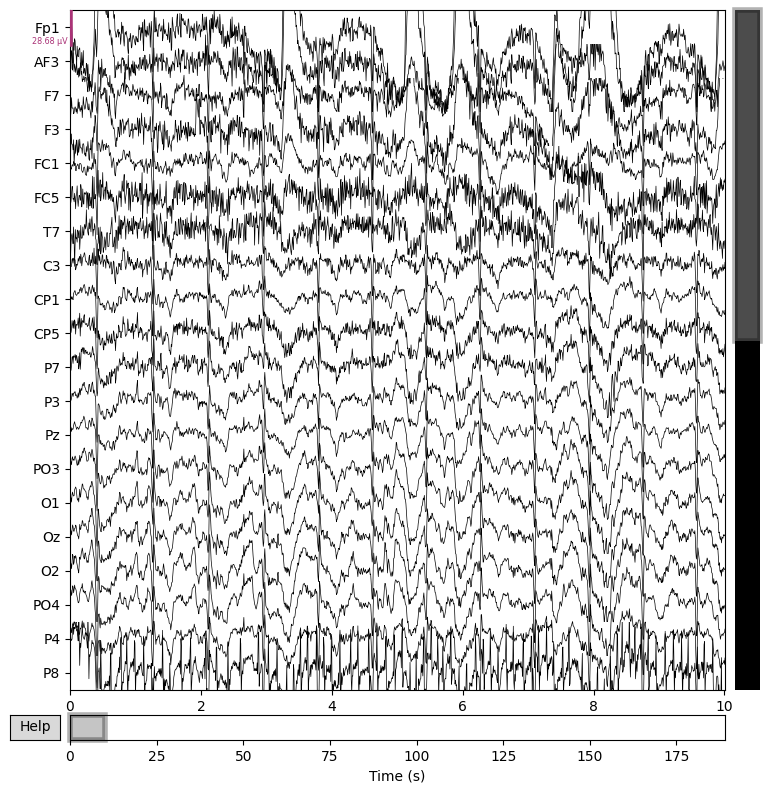

Loading and plotting preprocessed file: /content/preprocessed_data/Parkinson/sub-pd28_ses-on_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Parkinson/sub-pd28_ses-on_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 25727 =      0.000 ...   200.992 secs
Ready.
Reading 0 ... 25727  =      0.000 ...   200.992 secs...


<ipython-input-43-307b17ca18d5>:14: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd28_ses-on_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)


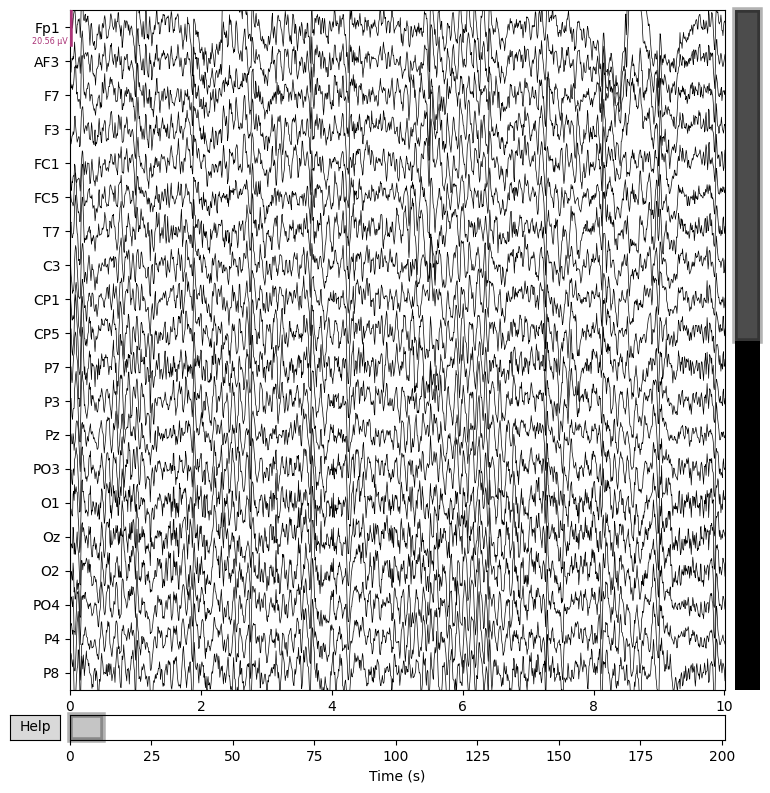

Loading and plotting preprocessed file: /content/preprocessed_data/Parkinson/sub-pd5_ses-on_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Parkinson/sub-pd5_ses-on_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 26367 =      0.000 ...   205.992 secs
Ready.
Reading 0 ... 26367  =      0.000 ...   205.992 secs...


<ipython-input-43-307b17ca18d5>:14: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd5_ses-on_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)


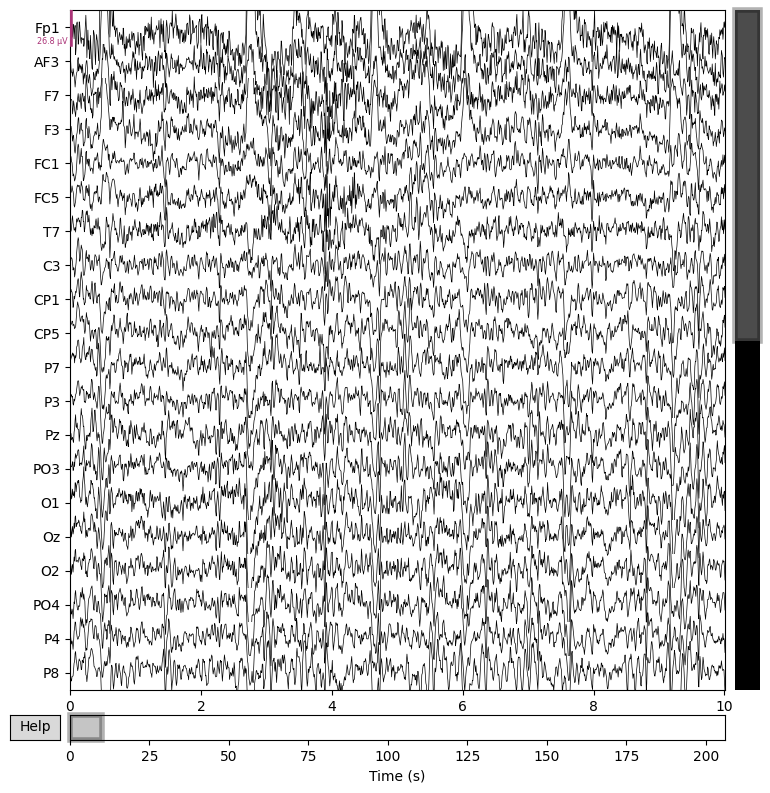

Loading and plotting preprocessed file: /content/preprocessed_data/Parkinson/sub-pd9_ses-off_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Parkinson/sub-pd9_ses-off_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 24447 =      0.000 ...   190.992 secs
Ready.
Reading 0 ... 24447  =      0.000 ...   190.992 secs...


<ipython-input-43-307b17ca18d5>:14: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd9_ses-off_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)


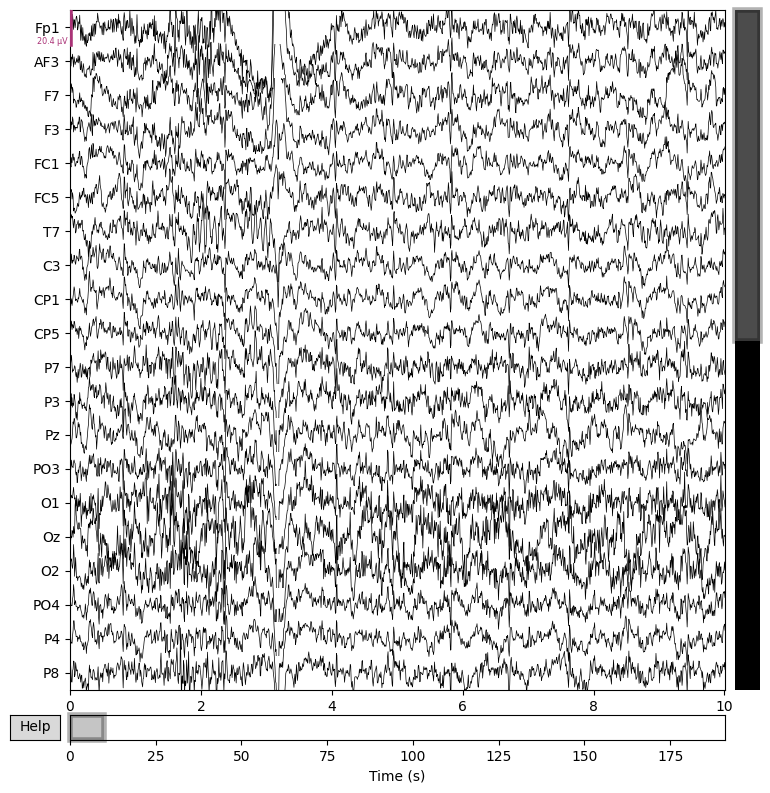

Loading and plotting preprocessed file: /content/preprocessed_data/Parkinson/sub-pd16_ses-off_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Parkinson/sub-pd16_ses-off_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 24063 =      0.000 ...   187.992 secs
Ready.
Reading 0 ... 24063  =      0.000 ...   187.992 secs...


<ipython-input-43-307b17ca18d5>:14: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd16_ses-off_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)


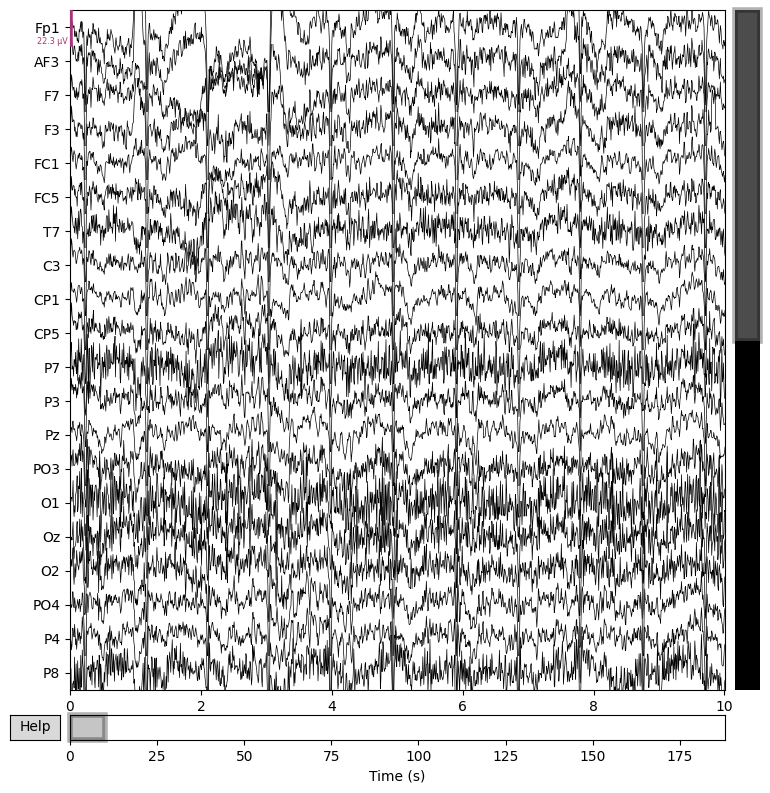

Loading and plotting preprocessed file: /content/preprocessed_data/Parkinson/sub-pd12_ses-off_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Parkinson/sub-pd12_ses-off_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 26495 =      0.000 ...   206.992 secs
Ready.
Reading 0 ... 26495  =      0.000 ...   206.992 secs...


<ipython-input-43-307b17ca18d5>:14: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd12_ses-off_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)


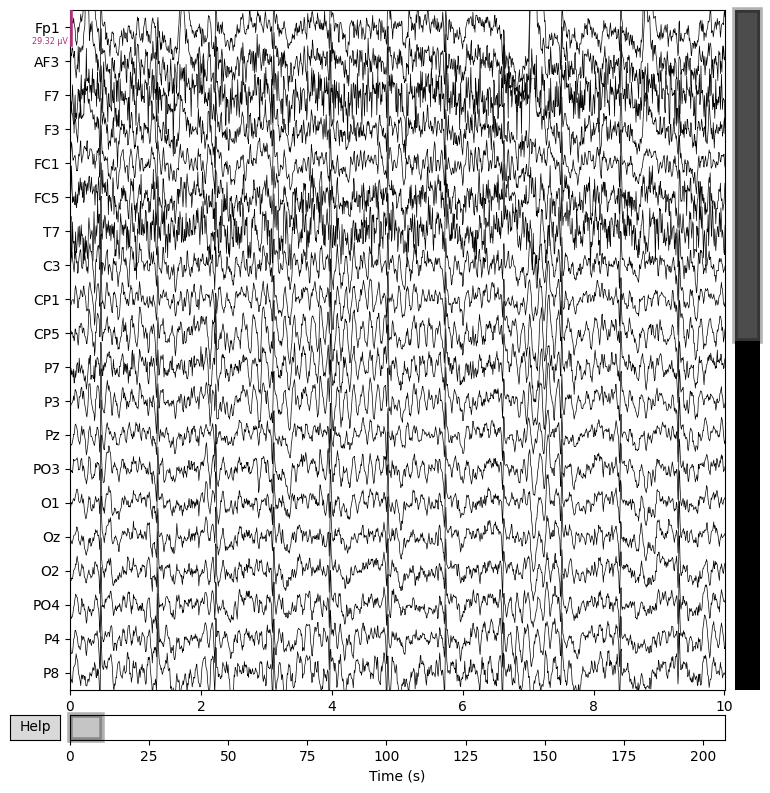

Loading and plotting preprocessed file: /content/preprocessed_data/Parkinson/sub-pd23_ses-off_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Parkinson/sub-pd23_ses-off_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 26111 =      0.000 ...   203.992 secs
Ready.
Reading 0 ... 26111  =      0.000 ...   203.992 secs...


<ipython-input-43-307b17ca18d5>:14: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd23_ses-off_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)


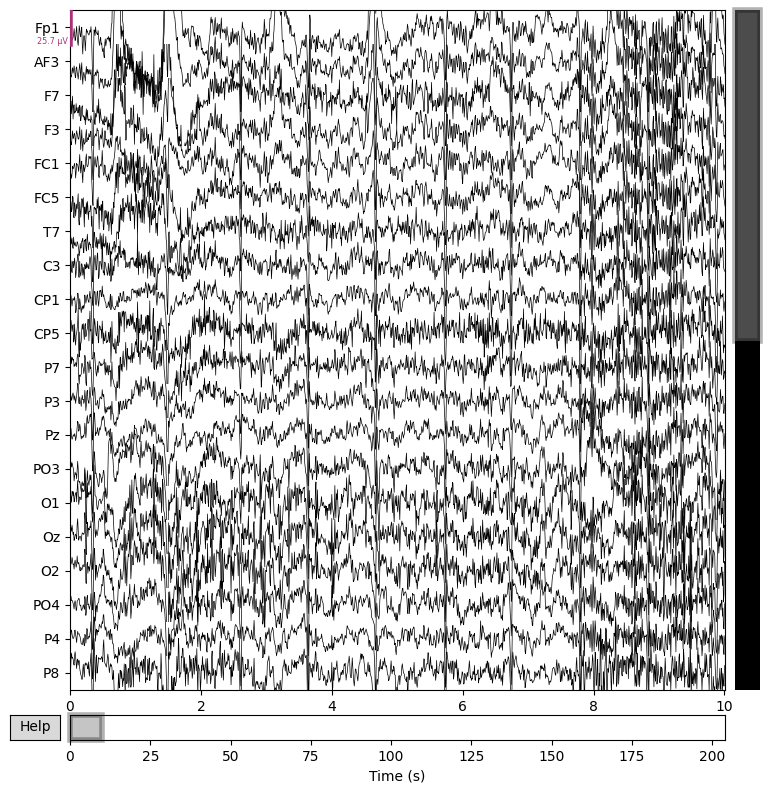

Loading and plotting preprocessed file: /content/preprocessed_data/Parkinson/sub-pd28_ses-off_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Parkinson/sub-pd28_ses-off_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 26367 =      0.000 ...   205.992 secs
Ready.
Reading 0 ... 26367  =      0.000 ...   205.992 secs...


<ipython-input-43-307b17ca18d5>:14: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd28_ses-off_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)


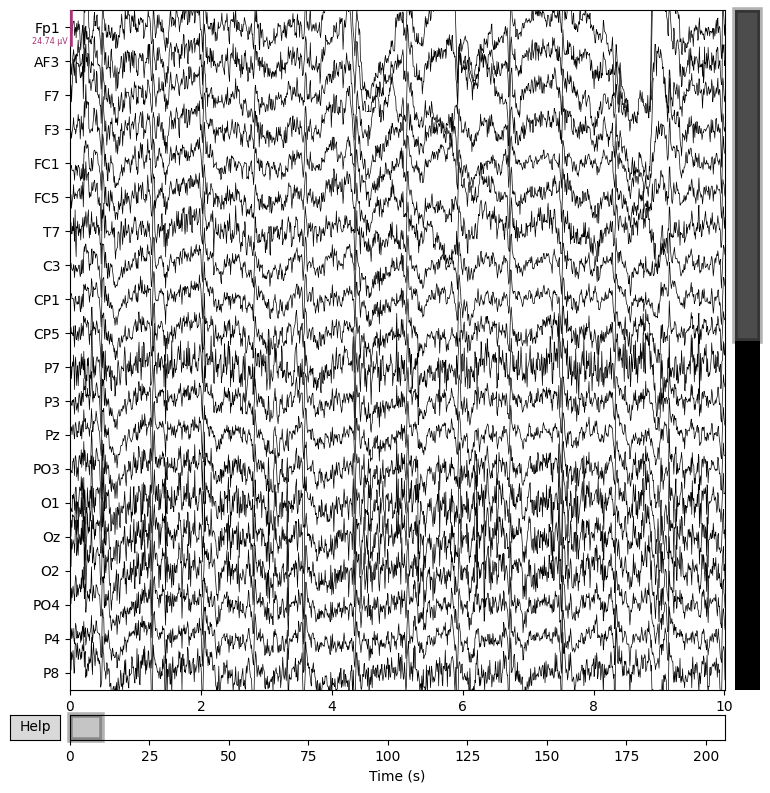

Loading and plotting preprocessed file: /content/preprocessed_data/Parkinson/sub-pd26_ses-on_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Parkinson/sub-pd26_ses-on_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 27647 =      0.000 ...   215.992 secs
Ready.
Reading 0 ... 27647  =      0.000 ...   215.992 secs...


<ipython-input-43-307b17ca18d5>:14: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd26_ses-on_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)


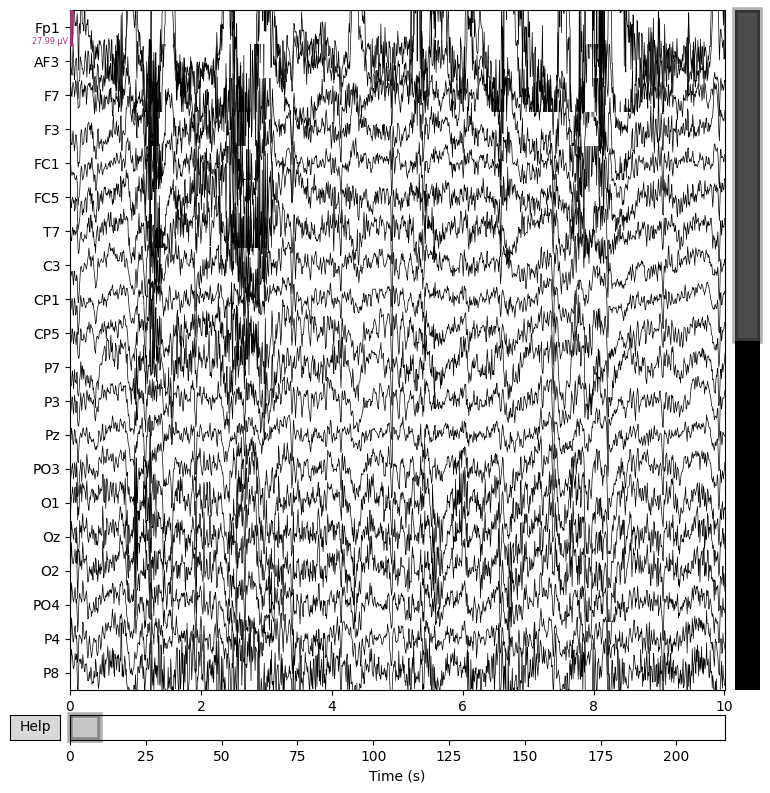

Loading and plotting preprocessed file: /content/preprocessed_data/Parkinson/sub-pd6_ses-on_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Parkinson/sub-pd6_ses-on_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 36991 =      0.000 ...   288.992 secs
Ready.
Reading 0 ... 36991  =      0.000 ...   288.992 secs...


<ipython-input-43-307b17ca18d5>:14: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd6_ses-on_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)


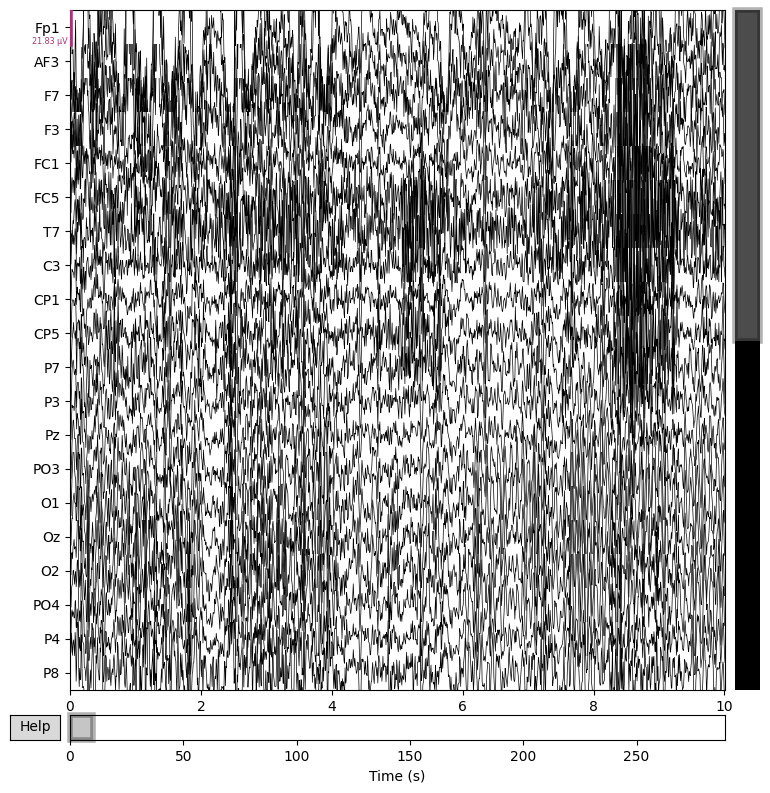

Loading and plotting preprocessed file: /content/preprocessed_data/Parkinson/sub-pd5_ses-off_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Parkinson/sub-pd5_ses-off_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 25215 =      0.000 ...   196.992 secs
Ready.
Reading 0 ... 25215  =      0.000 ...   196.992 secs...


<ipython-input-43-307b17ca18d5>:14: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd5_ses-off_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)


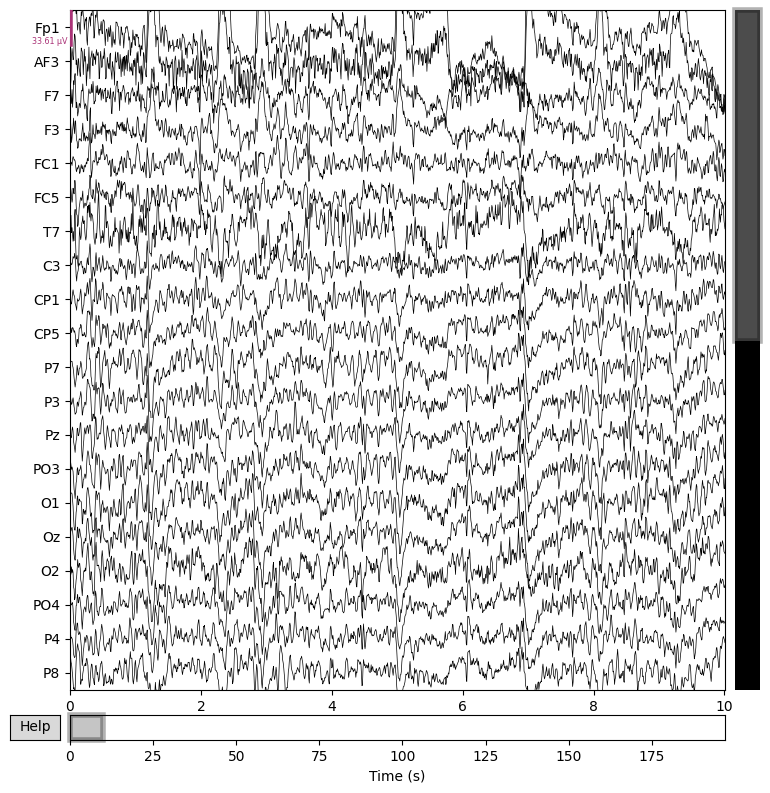

In [45]:
# Plot preprocessed data from Parkinson folder
print("Plotting Parkinson Preprocessed Files...")
plot_preprocessed_data(preprocessed_parkinson_folder)

In [46]:
import os
import mne
import numpy as np
from sklearn.model_selection import train_test_split

# Function to load and prepare data from a folder for model training
def load_and_prepare_data(folder_path, label, n_channels=64, n_timepoints=5000):
    """
    Load EEG data from .fif files, standardize shape, and create labels.

    Args:
        folder_path: Path to the folder with preprocessed .fif files.
        label: Label for the data (0 for Healthy, 1 for Parkinson).
        n_channels: Number of EEG channels (default: 64).
        n_timepoints: Fixed number of timepoints for all recordings (default: 5000).

    Returns:
        data: List of EEG data arrays (channels x timepoints).
        labels: Corresponding labels for the data (0 or 1).
    """
    data = []
    labels = []

    # Iterate over all files in the folder
    for file_name in os.listdir(folder_path):
        if file_name.endswith("-preprocessed.fif"):  # Only process preprocessed .fif files
            file_path = os.path.join(folder_path, file_name)
            print(f"Loading file: {file_path}")

            # Load preprocessed data
            raw_data = mne.io.read_raw_fif(file_path, preload=True)

            # Get data array (channels x timepoints)
            eeg_data = raw_data.get_data()  # Shape: (n_channels, n_times)

            # Standardize shape to have n_timepoints (either trim or pad the data)
            if eeg_data.shape[1] > n_timepoints:  # Trim the data
                eeg_data = eeg_data[:, :n_timepoints]
            elif eeg_data.shape[1] < n_timepoints:  # Pad the data
                padding = np.zeros((eeg_data.shape[0], n_timepoints - eeg_data.shape[1]))
                eeg_data = np.concatenate((eeg_data, padding), axis=1)

            # Add data and label to the lists
            data.append(eeg_data)
            labels.append(label)

    return np.array(data), np.array(labels)

# Paths for preprocessed Healthy and Parkinson data
preprocessed_healthy_folder = "/content/preprocessed_data/Healthy"
preprocessed_parkinson_folder = "/content/preprocessed_data/Parkinson"

# Load Healthy and Parkinson data
healthy_data, healthy_labels = load_and_prepare_data(preprocessed_healthy_folder, label=0)  # Healthy = 0
parkinson_data, parkinson_labels = load_and_prepare_data(preprocessed_parkinson_folder, label=1)  # Parkinson = 1

# Combine the data and labels from both Healthy and Parkinson
X_data = np.concatenate((healthy_data, parkinson_data), axis=0)
y_labels = np.concatenate((healthy_labels, parkinson_labels), axis=0)

# Shuffle the data (important for training)
indices = np.arange(len(X_data))
np.random.shuffle(indices)
X_data = X_data[indices]
y_labels = y_labels[indices]

# Split the data into training and testing sets (80% train, 20% test)
X_train, X_test, y_train, y_test = train_test_split(X_data, y_labels, test_size=0.2, random_state=42)

# Reshape the data to match the model's expected input shape (n_channels, n_timepoints, 1)
X_train = X_train.reshape(X_train.shape[0], X_train.shape[1], X_train.shape[2], 1)
X_test = X_test.reshape(X_test.shape[0], X_test.shape[1], X_test.shape[2], 1)

# Print the shapes of the training and testing data
print(f"Training data shape: {X_train.shape}")
print(f"Test data shape: {X_test.shape}")



Loading file: /content/preprocessed_data/Healthy/sub-hc21_ses-hc_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Healthy/sub-hc21_ses-hc_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 24191 =      0.000 ...   188.992 secs
Ready.
Reading 0 ... 24191  =      0.000 ...   188.992 secs...
Loading file: /content/preprocessed_data/Healthy/sub-hc24_ses-hc_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Healthy/sub-hc24_ses-hc_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 24575 =      0.000 ...   191.992 secs
Ready.
Reading 0 ... 24575  =      0.000 ...   191.992 secs...
Loading file: /content/preprocessed_data/Healthy/sub-hc1_ses-hc_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Healthy/sub-hc1_ses-hc_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 24575 =      0.000 ...   191.992 secs
Ready.
Reading 0 ... 24575  =      0.000 ... 

<ipython-input-46-de2c70e0e701>:31: RuntimeWarning: This filename (/content/preprocessed_data/Healthy/sub-hc21_ses-hc_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)
<ipython-input-46-de2c70e0e701>:31: RuntimeWarning: This filename (/content/preprocessed_data/Healthy/sub-hc24_ses-hc_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)
<ipython-input-46-de2c70e0e701>:31: RuntimeWarning: This filename (/content/preprocessed_data/Healthy/sub-hc1_ses-hc_task-rest_eeg

Isotrak not found
    Range : 0 ... 25087 =      0.000 ...   195.992 secs
Ready.
Reading 0 ... 25087  =      0.000 ...   195.992 secs...
Loading file: /content/preprocessed_data/Healthy/sub-hc33_ses-hc_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Healthy/sub-hc33_ses-hc_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 24319 =      0.000 ...   189.992 secs
Ready.
Reading 0 ... 24319  =      0.000 ...   189.992 secs...
Loading file: /content/preprocessed_data/Healthy/sub-hc20_ses-hc_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Healthy/sub-hc20_ses-hc_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 23551 =      0.000 ...   183.992 secs
Ready.
Reading 0 ... 23551  =      0.000 ...   183.992 secs...
Loading file: /content/preprocessed_data/Healthy/sub-hc30_ses-hc_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Healthy/sub-hc30_ses-hc_task-rest_eeg-

<ipython-input-46-de2c70e0e701>:31: RuntimeWarning: This filename (/content/preprocessed_data/Healthy/sub-hc33_ses-hc_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)
<ipython-input-46-de2c70e0e701>:31: RuntimeWarning: This filename (/content/preprocessed_data/Healthy/sub-hc20_ses-hc_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)
<ipython-input-46-de2c70e0e701>:31: RuntimeWarning: This filename (/content/preprocessed_data/Healthy/sub-hc30_ses-hc_task-rest_ee

Ready.
Reading 0 ... 25727  =      0.000 ...   200.992 secs...
Loading file: /content/preprocessed_data/Healthy/sub-hc25_ses-hc_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Healthy/sub-hc25_ses-hc_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 25855 =      0.000 ...   201.992 secs
Ready.
Reading 0 ... 25855  =      0.000 ...   201.992 secs...
Loading file: /content/preprocessed_data/Healthy/sub-hc18_ses-hc_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Healthy/sub-hc18_ses-hc_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 23807 =      0.000 ...   185.992 secs
Ready.
Reading 0 ... 23807  =      0.000 ...   185.992 secs...
Loading file: /content/preprocessed_data/Healthy/sub-hc7_ses-hc_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Healthy/sub-hc7_ses-hc_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 24575 =      0.000 .

<ipython-input-46-de2c70e0e701>:31: RuntimeWarning: This filename (/content/preprocessed_data/Healthy/sub-hc25_ses-hc_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)
<ipython-input-46-de2c70e0e701>:31: RuntimeWarning: This filename (/content/preprocessed_data/Healthy/sub-hc18_ses-hc_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)
<ipython-input-46-de2c70e0e701>:31: RuntimeWarning: This filename (/content/preprocessed_data/Healthy/sub-hc7_ses-hc_task-rest_eeg

Ready.
Reading 0 ... 23551  =      0.000 ...   183.992 secs...
Loading file: /content/preprocessed_data/Parkinson/sub-pd13_ses-on_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Parkinson/sub-pd13_ses-on_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 23935 =      0.000 ...   186.992 secs
Ready.
Reading 0 ... 23935  =      0.000 ...   186.992 secs...
Loading file: /content/preprocessed_data/Parkinson/sub-pd3_ses-on_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Parkinson/sub-pd3_ses-on_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 27263 =      0.000 ...   212.992 secs
Ready.
Reading 0 ... 27263  =      0.000 ...   212.992 secs...
Loading file: /content/preprocessed_data/Parkinson/sub-pd22_ses-off_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Parkinson/sub-pd22_ses-off_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 24063 

<ipython-input-46-de2c70e0e701>:31: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd13_ses-on_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)
<ipython-input-46-de2c70e0e701>:31: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd3_ses-on_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)
<ipython-input-46-de2c70e0e701>:31: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd22_ses-off_task-r

Loading file: /content/preprocessed_data/Parkinson/sub-pd9_ses-on_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Parkinson/sub-pd9_ses-on_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 23935 =      0.000 ...   186.992 secs
Ready.
Reading 0 ... 23935  =      0.000 ...   186.992 secs...
Loading file: /content/preprocessed_data/Parkinson/sub-pd12_ses-on_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Parkinson/sub-pd12_ses-on_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 24575 =      0.000 ...   191.992 secs
Ready.
Reading 0 ... 24575  =      0.000 ...   191.992 secs...
Loading file: /content/preprocessed_data/Parkinson/sub-pd14_ses-on_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Parkinson/sub-pd14_ses-on_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 24191 =      0.000 ...   188.992 secs
Ready.
Reading 0 ... 24191  =    

<ipython-input-46-de2c70e0e701>:31: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd9_ses-on_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)
<ipython-input-46-de2c70e0e701>:31: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd12_ses-on_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)
<ipython-input-46-de2c70e0e701>:31: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd14_ses-on_task-re

Loading file: /content/preprocessed_data/Parkinson/sub-pd13_ses-off_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Parkinson/sub-pd13_ses-off_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 23807 =      0.000 ...   185.992 secs
Ready.
Reading 0 ... 23807  =      0.000 ...   185.992 secs...
Loading file: /content/preprocessed_data/Parkinson/sub-pd19_ses-off_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Parkinson/sub-pd19_ses-off_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 23679 =      0.000 ...   184.992 secs
Ready.
Reading 0 ... 23679  =      0.000 ...   184.992 secs...
Loading file: /content/preprocessed_data/Parkinson/sub-pd16_ses-on_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Parkinson/sub-pd16_ses-on_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 23935 =      0.000 ...   186.992 secs
Ready.
Reading 0 ... 23935 

<ipython-input-46-de2c70e0e701>:31: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd13_ses-off_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)
<ipython-input-46-de2c70e0e701>:31: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd19_ses-off_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)
<ipython-input-46-de2c70e0e701>:31: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd16_ses-on_task

Loading file: /content/preprocessed_data/Parkinson/sub-pd17_ses-on_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Parkinson/sub-pd17_ses-on_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 23807 =      0.000 ...   185.992 secs
Ready.
Reading 0 ... 23807  =      0.000 ...   185.992 secs...
Loading file: /content/preprocessed_data/Parkinson/sub-pd14_ses-off_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Parkinson/sub-pd14_ses-off_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 37375 =      0.000 ...   291.992 secs
Ready.
Reading 0 ... 37375  =      0.000 ...   291.992 secs...
Loading file: /content/preprocessed_data/Parkinson/sub-pd17_ses-off_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Parkinson/sub-pd17_ses-off_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 24191 =      0.000 ...   188.992 secs
Ready.
Reading 0 ... 24191 

<ipython-input-46-de2c70e0e701>:31: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd17_ses-on_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)
<ipython-input-46-de2c70e0e701>:31: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd14_ses-off_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)
<ipython-input-46-de2c70e0e701>:31: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd17_ses-off_task

Loading file: /content/preprocessed_data/Parkinson/sub-pd9_ses-off_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Parkinson/sub-pd9_ses-off_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 24447 =      0.000 ...   190.992 secs
Ready.
Reading 0 ... 24447  =      0.000 ...   190.992 secs...
Loading file: /content/preprocessed_data/Parkinson/sub-pd16_ses-off_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Parkinson/sub-pd16_ses-off_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 24063 =      0.000 ...   187.992 secs
Ready.
Reading 0 ... 24063  =      0.000 ...   187.992 secs...
Loading file: /content/preprocessed_data/Parkinson/sub-pd12_ses-off_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Parkinson/sub-pd12_ses-off_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 26495 =      0.000 ...   206.992 secs
Ready.
Reading 0 ... 26495 

<ipython-input-46-de2c70e0e701>:31: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd9_ses-off_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)
<ipython-input-46-de2c70e0e701>:31: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd16_ses-off_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)
<ipython-input-46-de2c70e0e701>:31: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd12_ses-off_task

Reading 0 ... 26367  =      0.000 ...   205.992 secs...
Loading file: /content/preprocessed_data/Parkinson/sub-pd26_ses-on_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Parkinson/sub-pd26_ses-on_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 27647 =      0.000 ...   215.992 secs
Ready.
Reading 0 ... 27647  =      0.000 ...   215.992 secs...
Loading file: /content/preprocessed_data/Parkinson/sub-pd6_ses-on_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Parkinson/sub-pd6_ses-on_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 36991 =      0.000 ...   288.992 secs
Ready.
Reading 0 ... 36991  =      0.000 ...   288.992 secs...
Loading file: /content/preprocessed_data/Parkinson/sub-pd5_ses-off_task-rest_eeg-preprocessed.fif
Opening raw data file /content/preprocessed_data/Parkinson/sub-pd5_ses-off_task-rest_eeg-preprocessed.fif...
Isotrak not found
    Range : 0 ... 25215 =      0.

<ipython-input-46-de2c70e0e701>:31: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd26_ses-on_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)
<ipython-input-46-de2c70e0e701>:31: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd6_ses-on_task-rest_eeg-preprocessed.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = mne.io.read_raw_fif(file_path, preload=True)
<ipython-input-46-de2c70e0e701>:31: RuntimeWarning: This filename (/content/preprocessed_data/Parkinson/sub-pd5_ses-off_task-re

Training data shape: (36, 41, 5000, 1)
Test data shape: (10, 41, 5000, 1)


In [47]:
import shutil
import os
import numpy as np

# Define the paths for future test data
future_test_healthy_folder = "/content/future_test_data/Healthy"
future_test_parkinson_folder = "/content/future_test_data/Parkinson"

# Create the future test data folders if they don't exist
os.makedirs(future_test_healthy_folder, exist_ok=True)
os.makedirs(future_test_parkinson_folder, exist_ok=True)

# Function to move 2 test files from Healthy and Parkinson datasets
def move_future_test_data(healthy_files, parkinson_files, num_test=2):
    # Randomly select num_test files from Healthy and Parkinson data
    selected_healthy = np.random.choice(healthy_files, num_test, replace=False)
    selected_parkinson = np.random.choice(parkinson_files, num_test, replace=False)

    # Move selected Healthy files to future test folder
    for file in selected_healthy:
        shutil.move(file, os.path.join(future_test_healthy_folder, os.path.basename(file)))
        print(f"Moved {os.path.basename(file)} to future test Healthy folder")

    # Move selected Parkinson files to future test folder
    for file in selected_parkinson:
        shutil.move(file, os.path.join(future_test_parkinson_folder, os.path.basename(file)))
        print(f"Moved {os.path.basename(file)} to future test Parkinson folder")

# List all preprocessed files from Healthy and Parkinson datasets
healthy_files = [os.path.join(preprocessed_healthy_folder, f) for f in os.listdir(preprocessed_healthy_folder) if f.endswith("-preprocessed.fif")]
parkinson_files = [os.path.join(preprocessed_parkinson_folder, f) for f in os.listdir(preprocessed_parkinson_folder) if f.endswith("-preprocessed.fif")]

# Move 2 test samples from both Healthy and Parkinson data
move_future_test_data(healthy_files, parkinson_files, num_test=2)

# Print the remaining files in the original folders
print(f"Remaining Healthy Files: {len(healthy_files) - 2}")
print(f"Remaining Parkinson Files: {len(parkinson_files) - 2}")


Moved sub-hc29_ses-hc_task-rest_eeg-preprocessed.fif to future test Healthy folder
Moved sub-hc33_ses-hc_task-rest_eeg-preprocessed.fif to future test Healthy folder
Moved sub-pd3_ses-on_task-rest_eeg-preprocessed.fif to future test Parkinson folder
Moved sub-pd23_ses-on_task-rest_eeg-preprocessed.fif to future test Parkinson folder
Remaining Healthy Files: 14
Remaining Parkinson Files: 28


In [48]:
import tensorflow as tf
from tensorflow.keras import layers, models

# Function to build the CNN-LSTM model
def build_hybrid_cnn_lstm_model(input_shape):
    """
    Build a hybrid CNN-LSTM model for EEG classification.

    Args:
        input_shape: Shape of the input data (n_channels, n_timepoints, 1).

    Returns:
        A compiled CNN-LSTM model.
    """
    model = models.Sequential()

    # CNN Block
    model.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=input_shape))
    model.add(layers.BatchNormalization())
    model.add(layers.MaxPooling2D((2, 2)))
    model.add(layers.Dropout(0.3))

    model.add(layers.Conv2D(64, (3, 3), activation='relu'))
    model.add(layers.BatchNormalization())
    model.add(layers.MaxPooling2D((2, 2)))
    model.add(layers.Dropout(0.3))

    # Flatten the output of the CNN layers before passing to LSTM
    model.add(layers.Reshape((-1, 64)))  # Flatten the spatial features

    # LSTM Block
    model.add(layers.LSTM(64, return_sequences=True))
    model.add(layers.LSTM(32))

    # Fully Connected Layer for classification
    model.add(layers.Dense(64, activation='relu'))
    model.add(layers.Dropout(0.3))
    model.add(layers.Dense(1, activation='sigmoid'))  # Output for binary classification (PD or not)

    # Compile the model
    model.compile(optimizer='adam',
                  loss='binary_crossentropy',
                  metrics=['accuracy'])

    return model

# Input shape: (n_channels, n_timepoints, 1)
input_shape = (41, 5000, 1)  # Example dimensions (adjust to your dataset)

# Build the hybrid model
model = build_hybrid_cnn_lstm_model(input_shape)
model.summary()


/usr/local/lib/python3.11/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                      │ (None, 39, 4998, 32)        │             320 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization                  │ (None, 39, 4998, 32)        │             128 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d (MaxPooling2D)         │ (None, 19, 2499, 32)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 19, 2499, 32)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 17, 2497, 64)        │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_1                │ (None, 17, 2497, 64)        │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_1 (MaxPooling2D)       │ (None, 8, 1248, 64)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 8, 1248, 64)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ reshape (Reshape)                    │ (None, 9984, 64)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm (LSTM)                          │ (None, 9984, 64)            │          33,024 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm_1 (LSTM)                        │ (None, 32)                  │          12,416 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 64)                  │           2,112 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_2 (Dropout)                  │ (None, 64)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 1)                   │              65 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 66,817 (261.00 KB)

 Trainable params: 66,625 (260.25 KB)

 Non-trainable params: 192 (768.00 B)

In [49]:
from tensorflow.keras.callbacks import EarlyStopping

# Define early stopping criteria
early_stopping = EarlyStopping(monitor='val_loss',  # Monitor validation loss
                               patience=5,  # Stop after 5 epochs of no improvement
                               restore_best_weights=True)  # Restore the best weights

# Train the model
history = model.fit(
    X_train, y_train,
    epochs=30,  # Start with 30 epochs
    batch_size=32,
    validation_data=(X_test, y_test),
    callbacks=[early_stopping]  # Include early stopping callback
)

# Evaluate the model on the test data
test_loss, test_accuracy = model.evaluate(X_test, y_test)
print(f"Test Loss: {test_loss}, Test Accuracy: {test_accuracy}")

Epoch 1/30
2/2 ━━━━━━━━━━━━━━━━━━━━ 103s 31s/step - accuracy: 0.6817 - loss: 0.6859 - val_accuracy: 0.6000 - val_loss: 0.6912
Epoch 2/30
2/2 ━━━━━━━━━━━━━━━━━━━━ 127s 32s/step - accuracy: 0.6736 - loss: 0.6621 - val_accuracy: 0.6000 - val_loss: 0.6888
Epoch 3/30
2/2 ━━━━━━━━━━━━━━━━━━━━ 81s 31s/step - accuracy: 0.6840 - loss: 0.6341 - val_accuracy: 0.6000 - val_loss: 0.6873
Epoch 4/30
2/2 ━━━━━━━━━━━━━━━━━━━━ 81s 31s/step - accuracy: 0.6528 - loss: 0.6531 - val_accuracy: 0.6000 - val_loss: 0.6863
Epoch 5/30
2/2 ━━━━━━━━━━━━━━━━━━━━ 82s 31s/step - accuracy: 0.6736 - loss: 0.6286 - val_accuracy: 0.6000 - val_loss: 0.6850
Epoch 6/30
2/2 ━━━━━━━━━━━━━━━━━━━━ 80s 30s/step - accuracy: 0.6632 - loss: 0.6233 - val_accuracy: 0.6000 - val_loss: 0.6841
Epoch 7/30
2/2 ━━━━━━━━━━━━━━━━━━━━ 85s 32s/step - accuracy: 0.6632 - loss: 0.6402 - val_accuracy: 0.6000 - val_loss: 0.6830
Epoch 8/30
2/2 ━━━━━━━━━━━━━━━━━━━━ 78s 30s/step - accuracy: 0.6632 - loss: 0.6362 - val_accuracy: 0.6000 - val_loss: 0.681

In [55]:
from tensorflow.keras import layers, models, regularizers

def build_simpler_cnn_model(input_shape):
    model = models.Sequential()

    # First CNN block
    model.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=input_shape,
                            kernel_regularizer=regularizers.l2(0.01)))  # L2 regularization
    model.add(layers.MaxPooling2D((2, 2)))
    model.add(layers.Dropout(0.5))  # Increase dropout

    # Second CNN block
    model.add(layers.Conv2D(64, (3, 3), activation='relu',
                            kernel_regularizer=regularizers.l2(0.01)))  # L2 regularization
    model.add(layers.MaxPooling2D((2, 2)))
    model.add(layers.Dropout(0.5))  # Increase dropout

    # Flatten and Dense layers for classification
    model.add(layers.Flatten())
    model.add(layers.Dense(64, activation='relu'))
    model.add(layers.Dropout(0.5))  # Increased dropout
    model.add(layers.Dense(1, activation='sigmoid'))  # Output layer for binary classification

    # Compile the model with a lower learning rate
    model.compile(optimizer=Adam(learning_rate=0.00001),  # Lower learning rate
                  loss='binary_crossentropy',
                  metrics=['accuracy'])

    return model


# Input shape of the data (n_channels, n_timepoints, 1)
input_shape = (41, 5000, 1)  # Adjust this to your dataset

# Build the model
model = build_simpler_cnn_model(input_shape)
model.summary()





Model: "sequential_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_8 (Conv2D)                    │ (None, 39, 4998, 32)        │             320 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_8 (MaxPooling2D)       │ (None, 19, 2499, 32)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_12 (Dropout)                 │ (None, 19, 2499, 32)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_9 (Conv2D)                    │ (None, 17, 2497, 64)        │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_9 (MaxPooling2D)       │ (None, 8, 1248, 64)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_13 (Dropout)                 │ (None, 8, 1248, 64)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_3 (Flatten)                  │ (None, 638976)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_8 (Dense)                      │ (None, 64)                  │      40,894,528 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_14 (Dropout)                 │ (None, 64)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_9 (Dense)                      │ (None, 1)                   │              65 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 40,913,409 (156.07 MB)

 Trainable params: 40,913,409 (156.07 MB)

 Non-trainable params: 0 (0.00 B)

In [56]:
# Define early stopping to avoid overfitting
early_stopping = EarlyStopping(monitor='val_loss',  # Monitor validation loss
                               patience=10,  # Stop if no improvement after 10 epochs
                               restore_best_weights=True)  # Restore the best weights when training stops

# Train the model
history = model.fit(
    X_train, y_train,  # Training data and labels
    epochs=30,  # Try 30 epochs to see if the model converges
    batch_size=16,  # You can experiment with smaller batch sizes (e.g., 16 or 8)
    validation_data=(X_test, y_test),  # Validation data for monitoring
    callbacks=[early_stopping]  # Use early stopping to prevent overfitting
)

# Evaluate the model on the test data
test_loss, test_accuracy = model.evaluate(X_test, y_test)
print(f"Test Loss: {test_loss}, Test Accuracy: {test_accuracy}")

Epoch 1/30
3/3 ━━━━━━━━━━━━━━━━━━━━ 19s 4s/step - accuracy: 0.5434 - loss: 1.1367 - val_accuracy: 0.6000 - val_loss: 1.1363
Epoch 2/30
3/3 ━━━━━━━━━━━━━━━━━━━━ 23s 4s/step - accuracy: 0.6615 - loss: 1.1362 - val_accuracy: 0.6000 - val_loss: 1.1358
Epoch 3/30
3/3 ━━━━━━━━━━━━━━━━━━━━ 17s 3s/step - accuracy: 0.6458 - loss: 1.1356 - val_accuracy: 0.6000 - val_loss: 1.1352
Epoch 4/30
3/3 ━━━━━━━━━━━━━━━━━━━━ 14s 3s/step - accuracy: 0.7083 - loss: 1.1346 - val_accuracy: 0.6000 - val_loss: 1.1344
Epoch 5/30
3/3 ━━━━━━━━━━━━━━━━━━━━ 21s 4s/step - accuracy: 0.6693 - loss: 1.1336 - val_accuracy: 0.6000 - val_loss: 1.1335
Epoch 6/30
3/3 ━━━━━━━━━━━━━━━━━━━━ 12s 4s/step - accuracy: 0.6536 - loss: 1.1318 - val_accuracy: 0.6000 - val_loss: 1.1324
Epoch 7/30
3/3 ━━━━━━━━━━━━━━━━━━━━ 13s 3s/step - accuracy: 0.6771 - loss: 1.1290 - val_accuracy: 0.6000 - val_loss: 1.1309
Epoch 8/30
3/3 ━━━━━━━━━━━━━━━━━━━━ 21s 4s/step - accuracy: 0.6302 - loss: 1.1276 - val_accuracy: 0.6000 - val_loss: 1.1292
Epoch 9/

In [53]:
from tensorflow.keras import regularizers

def build_improved_cnn_model(input_shape):
    model = models.Sequential()

    # First CNN block
    model.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=input_shape,
                            kernel_regularizer=regularizers.l2(0.01)))  # L2 regularization
    model.add(layers.MaxPooling2D((2, 2)))
    model.add(layers.Dropout(0.5))  # Increase dropout

    # Second CNN block
    model.add(layers.Conv2D(64, (3, 3), activation='relu',
                            kernel_regularizer=regularizers.l2(0.01)))  # L2 regularization
    model.add(layers.MaxPooling2D((2, 2)))
    model.add(layers.Dropout(0.5))  # Increase dropout

    # Flatten and Dense layers for classification
    model.add(layers.Flatten())
    model.add(layers.Dense(64, activation='relu'))
    model.add(layers.Dropout(0.5))  # Increased dropout
    model.add(layers.Dense(1, activation='sigmoid'))  # Output layer for binary classification

    # Compile the model
    model.compile(optimizer=Adam(learning_rate=0.00001),  # Reduce learning rate further
                  loss='binary_crossentropy',
                  metrics=['accuracy'])

    return model

# Input shape of the data (n_channels, n_timepoints, 1)
input_shape = (41, 5000, 1)  # Adjust this to your dataset

# Build the model
model = build_simple_cnn_model(input_shape)
model.summary()

Model: "sequential_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_6 (Conv2D)                    │ (None, 39, 4998, 32)        │             320 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_6 (MaxPooling2D)       │ (None, 19, 2499, 32)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_9 (Dropout)                  │ (None, 19, 2499, 32)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_7 (Conv2D)                    │ (None, 17, 2497, 64)        │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_7 (MaxPooling2D)       │ (None, 8, 1248, 64)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_10 (Dropout)                 │ (None, 8, 1248, 64)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_2 (Flatten)                  │ (None, 638976)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_6 (Dense)                      │ (None, 64)                  │      40,894,528 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_11 (Dropout)                 │ (None, 64)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_7 (Dense)                      │ (None, 1)                   │              65 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 40,913,409 (156.07 MB)

 Trainable params: 40,913,409 (156.07 MB)

 Non-trainable params: 0 (0.00 B)

In [54]:
# Define early stopping with more patience
early_stopping = EarlyStopping(monitor='val_loss',  # Monitor validation loss
                               patience=10,  # Allow more epochs without improvement
                               restore_best_weights=True)  # Restore the best weights when training stops

# Train the model without early stopping
history = model.fit(
    X_train, y_train,  # Training data and labels
    epochs=30,  # Run for all 30 epochs
    batch_size=16,  # Batch size
    validation_data=(X_test, y_test)  # Validation data
)

# Evaluate the model on the test data
test_loss, test_accuracy = model.evaluate(X_test, y_test)
print(f"Test Loss: {test_loss}, Test Accuracy: {test_accuracy}")

Epoch 1/30
3/3 ━━━━━━━━━━━━━━━━━━━━ 17s 4s/step - accuracy: 0.6319 - loss: 0.6929 - val_accuracy: 0.6000 - val_loss: 0.6906
Epoch 2/30
3/3 ━━━━━━━━━━━━━━━━━━━━ 19s 3s/step - accuracy: 0.6771 - loss: 0.6837 - val_accuracy: 0.6000 - val_loss: 0.6807
Epoch 3/30
3/3 ━━━━━━━━━━━━━━━━━━━━ 22s 5s/step - accuracy: 0.6849 - loss: 0.6655 - val_accuracy: 0.6000 - val_loss: 0.6748
Epoch 4/30
3/3 ━━━━━━━━━━━━━━━━━━━━ 20s 3s/step - accuracy: 0.6927 - loss: 0.6336 - val_accuracy: 0.6000 - val_loss: 0.6735
Epoch 5/30
3/3 ━━━━━━━━━━━━━━━━━━━━ 19s 4s/step - accuracy: 0.6693 - loss: 0.6259 - val_accuracy: 0.6000 - val_loss: 0.6731
Epoch 6/30
3/3 ━━━━━━━━━━━━━━━━━━━━ 12s 3s/step - accuracy: 0.6693 - loss: 0.6323 - val_accuracy: 0.6000 - val_loss: 0.6757
Epoch 7/30
3/3 ━━━━━━━━━━━━━━━━━━━━ 23s 5s/step - accuracy: 0.6771 - loss: 0.6173 - val_accuracy: 0.6000 - val_loss: 0.6802
Epoch 8/30
3/3 ━━━━━━━━━━━━━━━━━━━━ 19s 3s/step - accuracy: 0.7005 - loss: 0.6338 - val_accuracy: 0.6000 - val_loss: 0.6772
Epoch 9/